In [10]:
## regular module imports
import cv2
import json
import matplotlib.pyplot as plt
import numpy as np
import os
from pathlib import Path
import pickle
import skimage
import skimage.io
import sys
import pandas as pd
import pycocotools.mask as RLE
import seaborn as sns


## detectron2
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.data import (
    DatasetCatalog,
    MetadataCatalog,
)
from detectron2.engine import DefaultTrainer, DefaultPredictor
from detectron2.structures import BoxMode

root = '../../../'
ocean_images = root + '../../../../ocean/projects/dmr200021p/sprice/tuning/'
sys.path.append(root)

from ampis import data_utils, visualize, analyze
from ampis.applications import powder
from ampis.structures import InstanceSet
from ampis.visualize import display_iset

In [11]:
#CONSTANTS
#--------------------------------------------------------------
EXPERIMENT_NAME = 'satellite' # can be 'particle' or 'satellite'
NUM_ITERATIONS = 5000
CHECKPOINT_NUM = 1000
NUM_CYCLES = 5
OUTPUT_FOLDER = 'DEMO_TEST2'
LR = 0.001
WD = 0.0001
BB = 'ResNet50'
#--------------------------------------------------------------

In [12]:
##LOADING DATA
json_path_train = Path('batch_jobs', 'SALAS_Rep', 'satellite_training.json')  # path to training data
json_path_val = Path('batch_jobs', 'SALAS_Rep', 'satellite_validation.json')  # path to training data
assert json_path_train.is_file(), 'training file not found!'
assert json_path_val.is_file(), 'validation file not found!'

In [13]:
## REGISTERING DATA

DatasetCatalog.clear()  # resets catalog, helps prevent errors from running cells multiple times

# store names of datasets that will be registered for easier access later
dataset_train = f'{EXPERIMENT_NAME}_Train'
dataset_valid = f'{EXPERIMENT_NAME}_Val'

# register the training dataset
DatasetCatalog.register(dataset_train, lambda f = json_path_train: data_utils.get_ddicts(label_fmt='via2',  # annotations generated from vgg image annotator
                                                                                                     im_root=f,  # path to the training data json file
                                                                                                     dataset_class='Train'))  # indicates this is training data
# register the validation dataset
DatasetCatalog.register(dataset_valid, lambda f = json_path_val: data_utils.get_ddicts(label_fmt='via2',  # annotations generated from vgg image annotator
                                                                                                im_root=f,  # path to validation data json file
                                                                                                dataset_class='Validation'))  # indicates this is validation data
                              
print(f'Registered Datasets: {DatasetCatalog.list()}')
## There is also a metadata catalog, which stores the class names.
for d in [dataset_train, dataset_valid]:
    MetadataCatalog.get(d).set(**{'thing_classes': [EXPERIMENT_NAME]})

Registered Datasets: ['satellite_Train', 'satellite_Val']


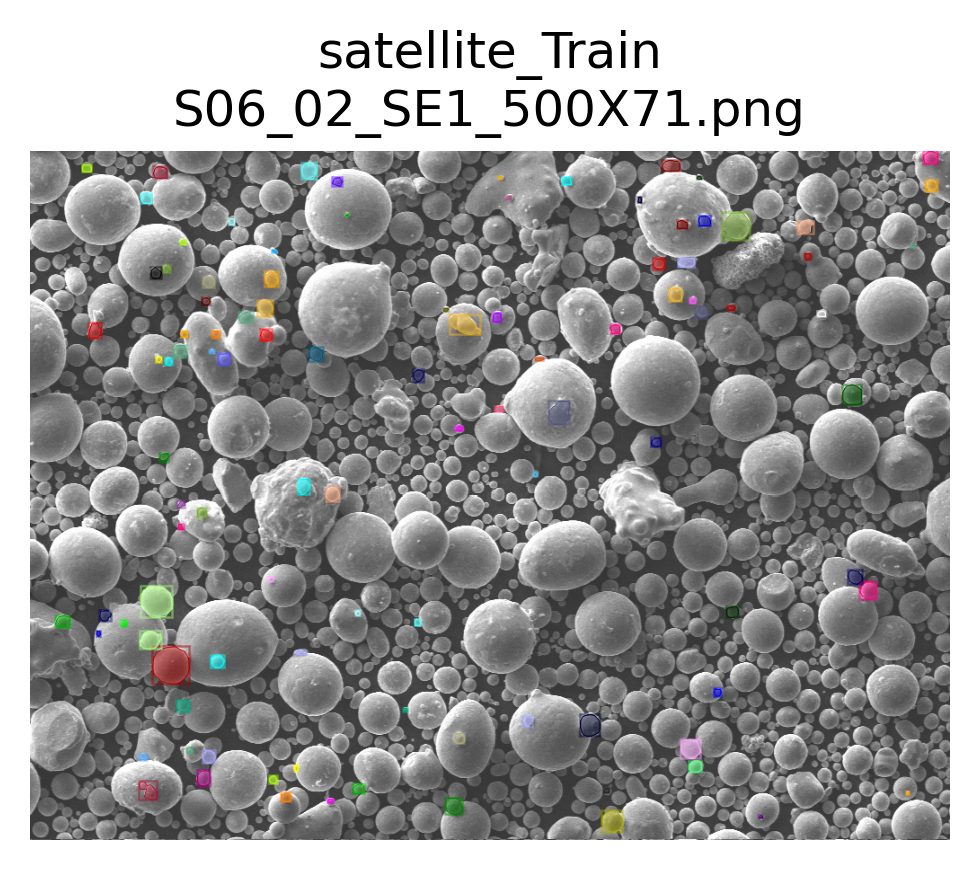

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_02_SE1_500X71.png
	num_instances: 104


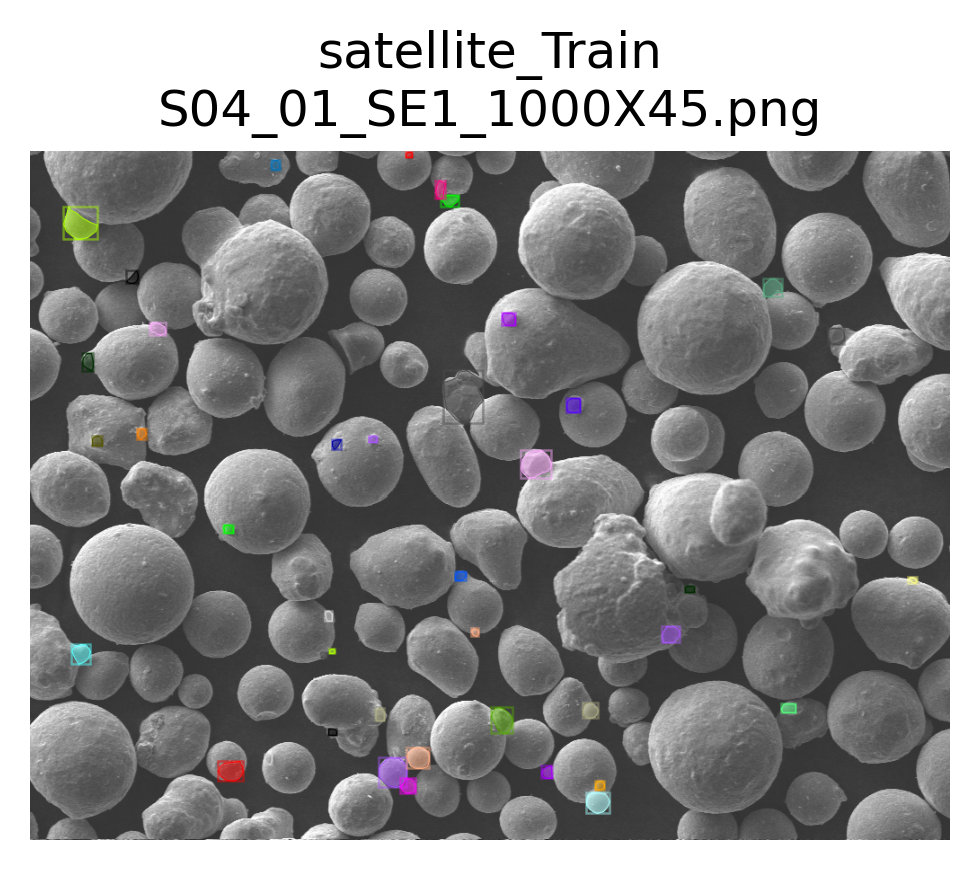

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_01_SE1_1000X45.png
	num_instances: 41


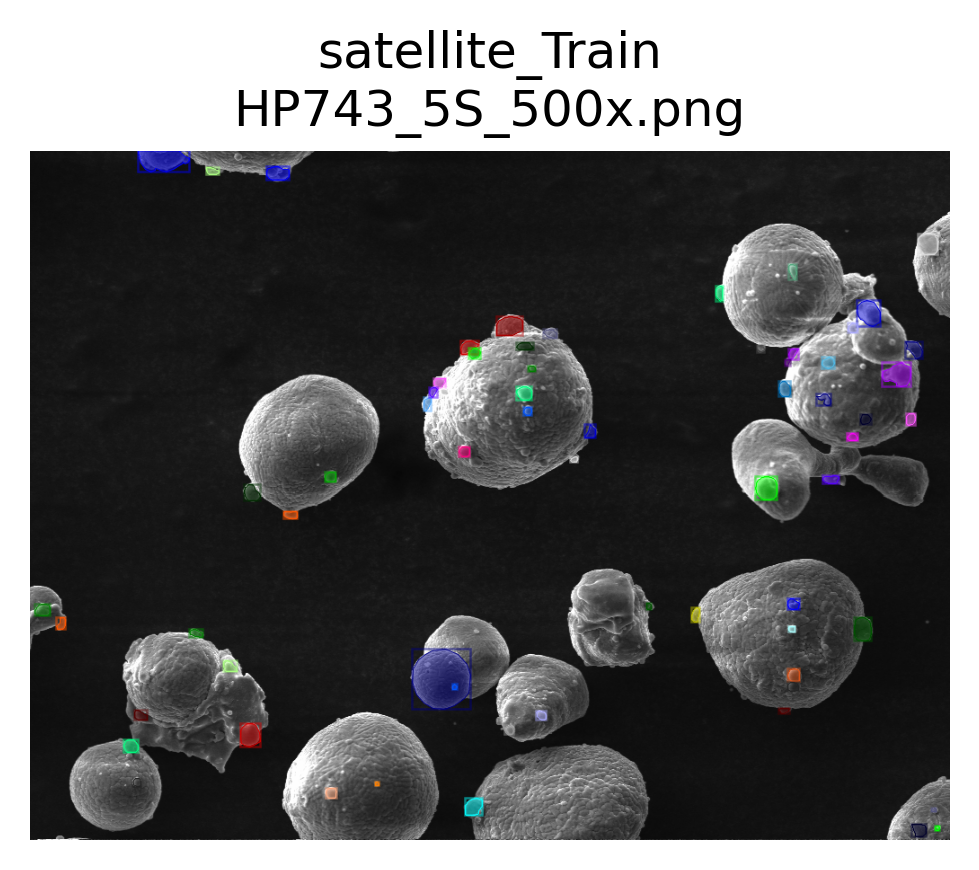

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_5S_500x.png
	num_instances: 65


In [14]:
#VERIFYING IMAGES LOADED PROPERLY
for i in np.random.choice(DatasetCatalog.get(dataset_train), 3, replace=False):
    visualize.display_ddicts(i, None, dataset_train, suppress_labels=True)

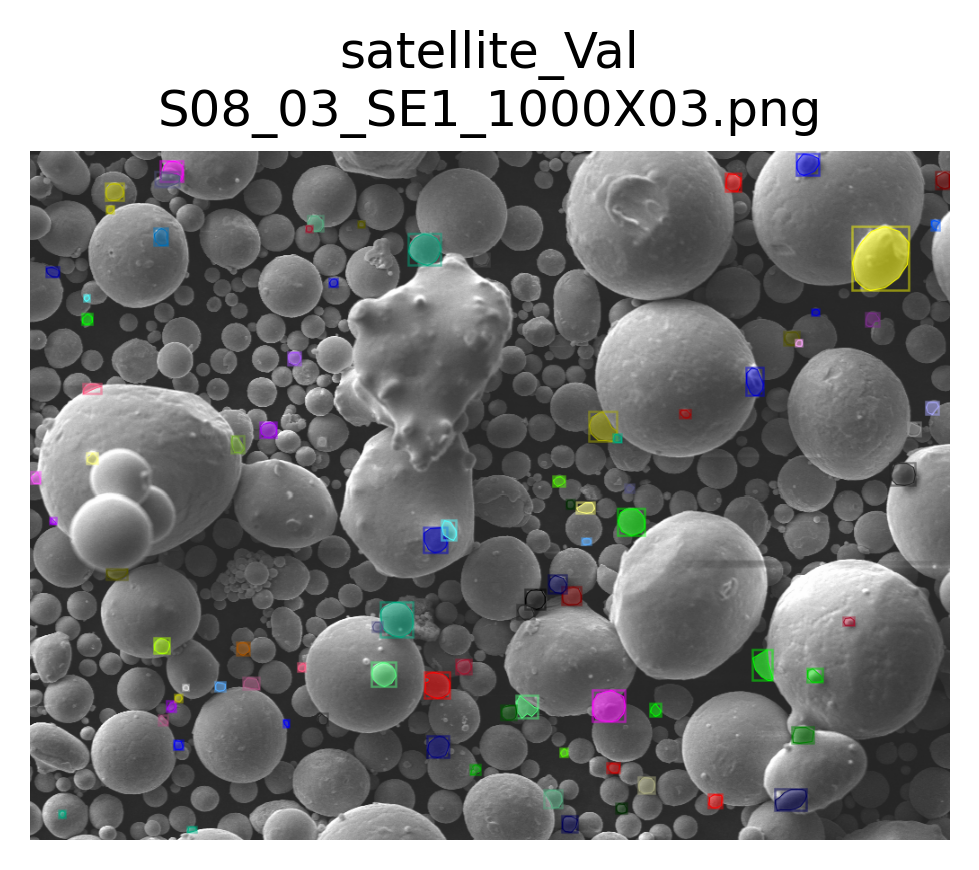

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png
	num_instances: 88


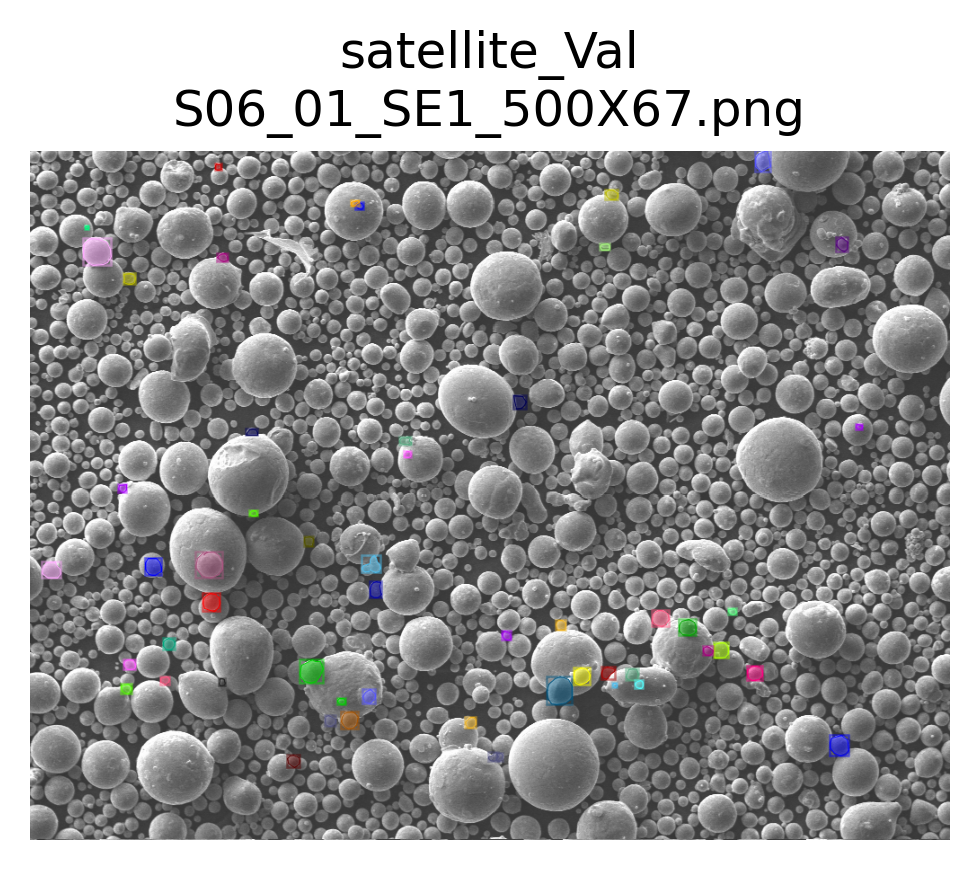

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png
	num_instances: 54


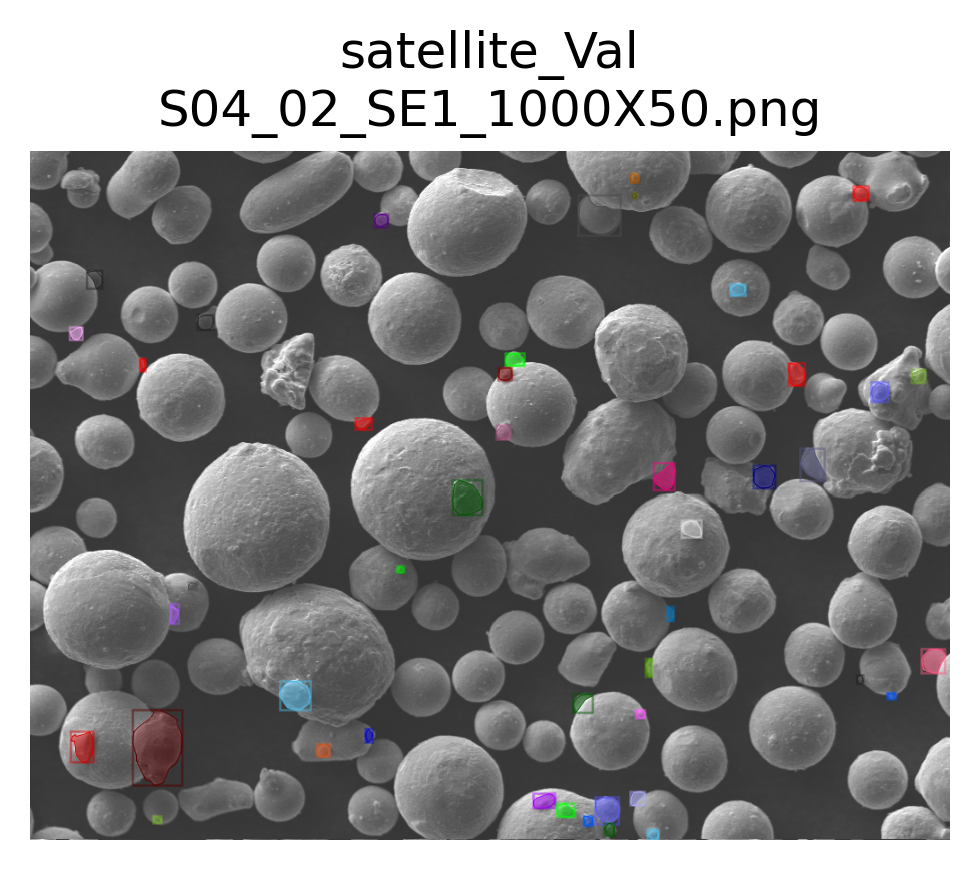

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png
	num_instances: 45


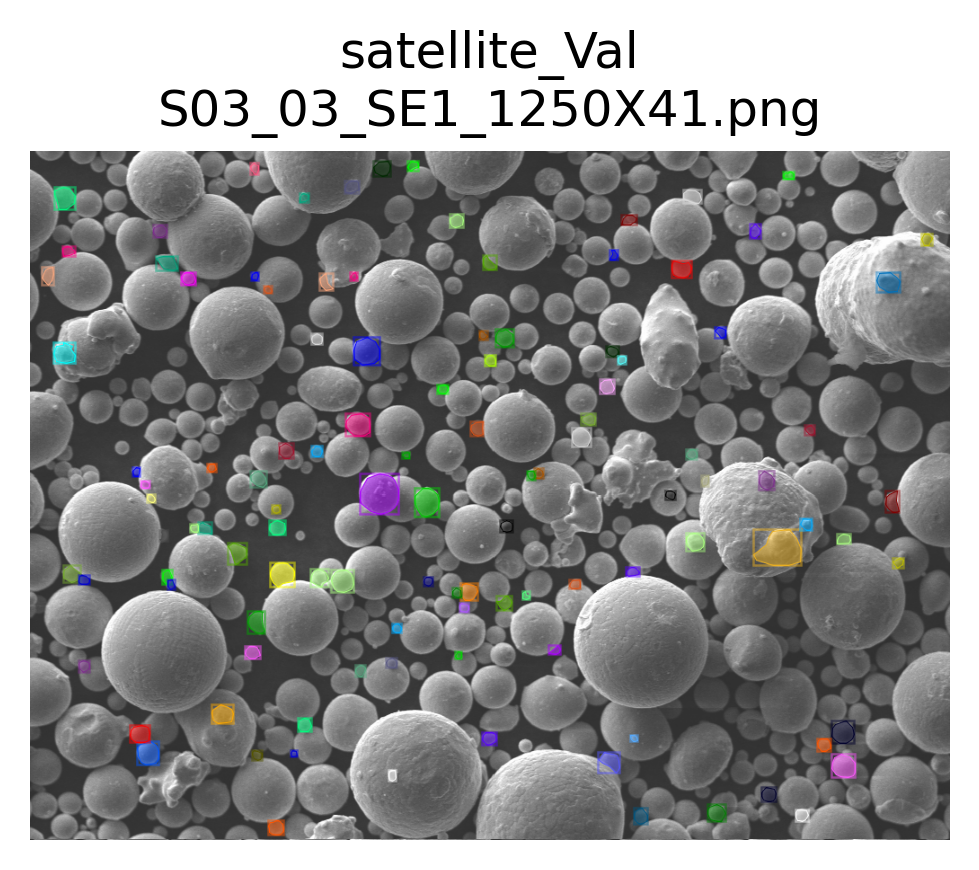

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png
	num_instances: 111


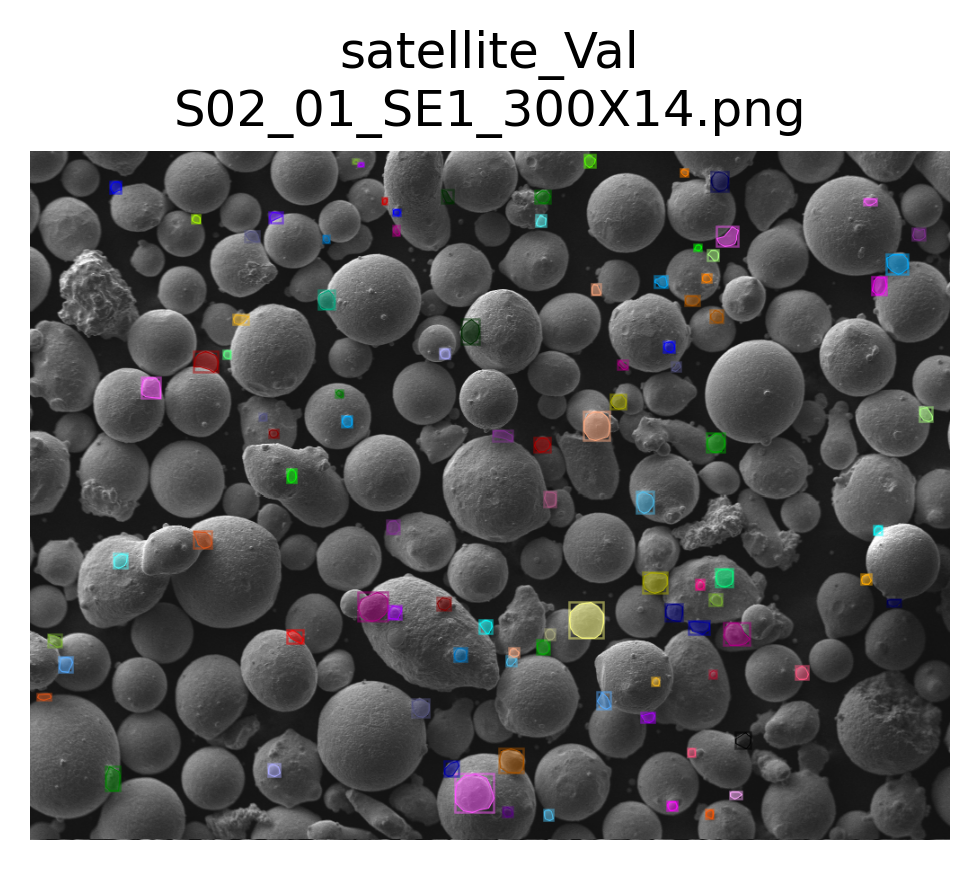

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png
	num_instances: 98


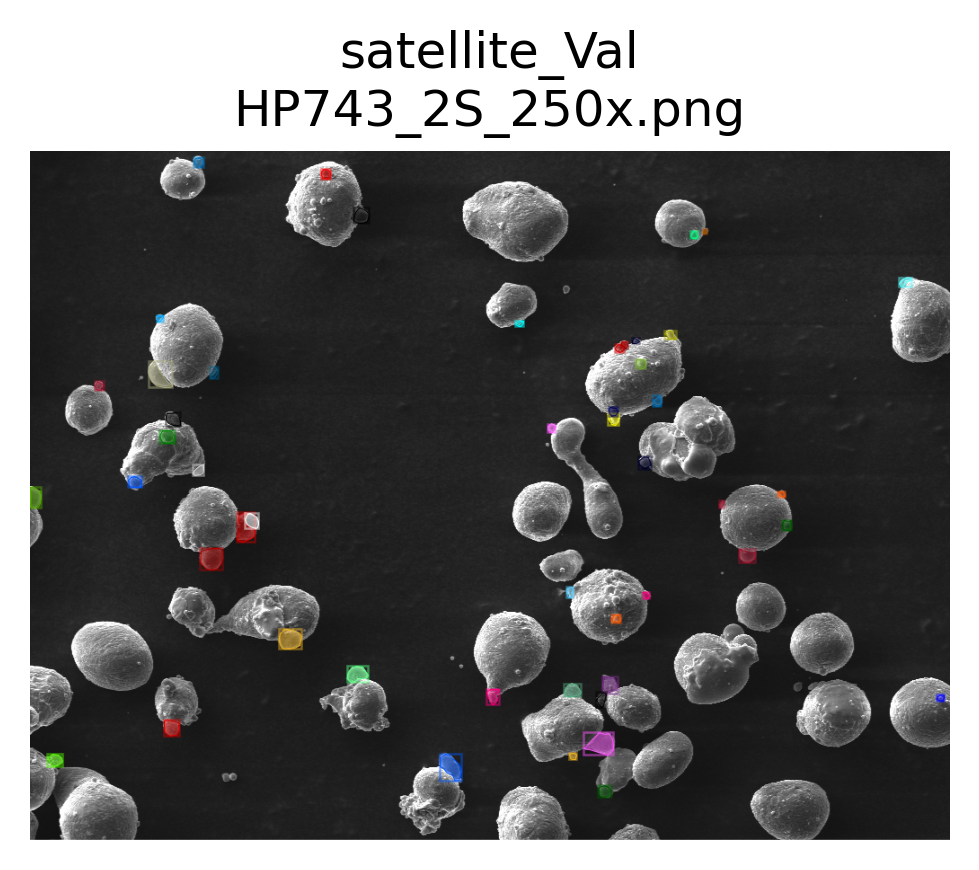

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png
	num_instances: 49


In [15]:
for i in DatasetCatalog.get(dataset_valid):
    visualize.display_ddicts(i, None, dataset_valid, suppress_labels=True)
    

In [16]:
#MODEL CONFIGS
cfg = get_cfg() # initialize cfg object
cfg.merge_from_file(model_zoo.get_config_file('COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml'))  # load default parameters for Mask R-CNN
cfg.INPUT.MASK_FORMAT = 'polygon'  # masks generated in VGG image annotator are polygons
cfg.DATASETS.TRAIN = (dataset_train,)  # dataset used for training model
cfg.DATASETS.VALIDATION = (dataset_valid,)
cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # we will look at the predictions on both sets after training
cfg.SOLVER.IMS_PER_BATCH = 1 # number of images per batch (across all machines)
cfg.SOLVER.CHECKPOINT_PERIOD = CHECKPOINT_NUM  # number of iterations after which to save model checkpoints
cfg.MODEL.DEVICE='cuda'  # 'cpu' to force model to run on cpu, 'cuda' if you have a compatible gpu
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1 # Since we are training separate models for particles and satellites there is only one class output
cfg.TEST.DETECTIONS_PER_IMAGE = 400 if EXPERIMENT_NAME == 'particle' else 250  # maximum number of instances that can be detected in an image (this is fixed in mask r-cnn)
cfg.SOLVER.MAX_ITER = NUM_ITERATIONS  # maximum number of iterations to run during training
                            # Increasing this may improve the training results, but will take longer to run (especially without a gpu!)
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.5
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.PANOPTIC_FPN.COMBINE.INSTANCES_CONFIDENCE_THRESH = 0.5
# model weights will be downloaded if they are not present
weights_path = Path('..','..','models','model_final_f10217.pkl')
if weights_path.is_file():
    print('Using locally stored weights: {}'.format(weights_path))
else:
    weights_path = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
    print('Weights not found, weights will be downloaded from source: {}'.format(weights_path))
cfg.MODEL.WEIGHTs = str(weights_path)
cfg.OUTPUT_DIR = str(Path(ocean_images, 'weights', OUTPUT_FOLDER))
# make the output directory
os.makedirs(Path(cfg.OUTPUT_DIR), exist_ok=True)

Weights not found, weights will be downloaded from source: https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl


In [17]:
print('--------------------------------')
print(cfg.SOLVER.BASE_LR)
print(cfg.SOLVER.WEIGHT_DECAY)
print(cfg.MODEL.RETINANET.SCORE_THRESH_TEST)
print(cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST)
print(cfg.MODEL.PANOPTIC_FPN.COMBINE.INSTANCES_CONFIDENCE_THRESH)
print(cfg.MODEL.ROI_HEADS.NUM_CLASSES)
print(cfg.SOLVER.IMS_PER_BATCH) 

--------------------------------
0.02
0.0001
0.05
0.05
0.5
1
1


In [18]:
#MODEL TRAINING
trainer = DefaultTrainer(cfg)  # create trainer object from cfg
trainer.resume_or_load(resume=False)  # start training from iteration 0
trainer.train()  # train the model!

[09/16 18:30:19 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

[09/16 18:30:21 d2.data.build]: Removed 0 images with no usable annotations. 20 images left.
[09/16 18:30:21 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
| satellite  | 1412         |
|            |              |
[09/16 18:30:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[09/16 18:30:21 d2.data.build]: Using training sampler TrainingSampler
[09/16 18:30:21 d2.data.common]: Serializing 20 elements to byte tensors and concatenating them all ...
[09/16 18:30:21 d2.data.common]: Serialized dataset takes 0.46 MiB
WARNING [09/16 18:30:21 d2.solver.build]: SOLVER.STEPS contains values larger than SOLVER.MAX_ITER. These values will be ignored.


/jet/home/sprice/.local/lib/python3.8/site-packages/torch/utils/data/dataloader.py:474: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 1, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[09/16 18:30:21 d2.checkpoint.c2_model_loading]: Renaming Caffe2 weights ......
[09/16 18:30:21 d2.checkpoint.c2_model_loading]: Following weights matched with submodule backbone.bottom_up:
| Names in Model    | Names in Checkpoint      | Shapes                                          |
|:------------------|:-------------------------|:------------------------------------------------|
| res2.0.conv1.*    | res2_0_branch2a_{bn_*,w} | (64,) (64,) (64,) (64,) (64,64,1,1)             |
| res2.0.conv2.*    | res2_0_branch2b_{bn_*,w} | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| res2.0.conv3.*    | res2_0_branch2c_{bn_*,w} | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| res2.0.shortcut.* | res2_0_branch1_{bn_*,w}  | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| res2.1.conv1.*    | res2_1_branch2a_{bn_*,w} | (64,) (64,) (64,) (64,) (64,256,1,1)            |
| res2.1.conv2.*    | res2_1_branch2b_{bn_*,w} | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| res2.1.conv3.*  

[09/16 18:31:04 d2.utils.events]:  eta: 0:11:35  iter: 219  total_loss: 1.684  loss_cls: 0.218  loss_box_reg: 0.3147  loss_mask: 0.3579  loss_rpn_cls: 0.2599  loss_rpn_loc: 0.5266  time: 0.1818  data_time: 0.0156  lr: 0.0043956  max_mem: 1822M
[09/16 18:31:07 d2.utils.events]:  eta: 0:11:32  iter: 239  total_loss: 1.831  loss_cls: 0.2421  loss_box_reg: 0.5018  loss_mask: 0.3452  loss_rpn_cls: 0.2322  loss_rpn_loc: 0.4873  time: 0.1786  data_time: 0.0146  lr: 0.0047952  max_mem: 1822M
[09/16 18:31:09 d2.utils.events]:  eta: 0:11:28  iter: 259  total_loss: 1.672  loss_cls: 0.2383  loss_box_reg: 0.4523  loss_mask: 0.3373  loss_rpn_cls: 0.2422  loss_rpn_loc: 0.4823  time: 0.1756  data_time: 0.0150  lr: 0.0051948  max_mem: 1822M
[09/16 18:31:12 d2.utils.events]:  eta: 0:11:23  iter: 279  total_loss: 1.759  loss_cls: 0.2285  loss_box_reg: 0.424  loss_mask: 0.3186  loss_rpn_cls: 0.2581  loss_rpn_loc: 0.5171  time: 0.1732  data_time: 0.0162  lr: 0.0055944  max_mem: 1822M
[09/16 18:31:15 d2.uti

[09/16 18:32:40 d2.utils.events]:  eta: 0:09:57  iter: 879  total_loss: 1.411  loss_cls: 0.1766  loss_box_reg: 0.3316  loss_mask: 0.2392  loss_rpn_cls: 0.1819  loss_rpn_loc: 0.4613  time: 0.1541  data_time: 0.0154  lr: 0.017582  max_mem: 1822M
[09/16 18:32:43 d2.utils.events]:  eta: 0:09:53  iter: 899  total_loss: 1.342  loss_cls: 0.1694  loss_box_reg: 0.3017  loss_mask: 0.2395  loss_rpn_cls: 0.1576  loss_rpn_loc: 0.4674  time: 0.1539  data_time: 0.0155  lr: 0.017982  max_mem: 1822M
[09/16 18:32:46 d2.utils.events]:  eta: 0:09:51  iter: 919  total_loss: 1.421  loss_cls: 0.21  loss_box_reg: 0.3552  loss_mask: 0.2293  loss_rpn_cls: 0.1702  loss_rpn_loc: 0.4492  time: 0.1537  data_time: 0.0153  lr: 0.018382  max_mem: 1822M
[09/16 18:32:49 d2.utils.events]:  eta: 0:09:48  iter: 939  total_loss: 1.411  loss_cls: 0.1961  loss_box_reg: 0.3875  loss_mask: 0.237  loss_rpn_cls: 0.1646  loss_rpn_loc: 0.4402  time: 0.1535  data_time: 0.0157  lr: 0.018781  max_mem: 1822M
[09/16 18:32:52 d2.utils.ev

[09/16 18:34:17 d2.utils.events]:  eta: 0:08:19  iter: 1539  total_loss: 1.45  loss_cls: 0.2278  loss_box_reg: 0.3982  loss_mask: 0.215  loss_rpn_cls: 0.1649  loss_rpn_loc: 0.413  time: 0.1503  data_time: 0.0158  lr: 0.02  max_mem: 1822M
[09/16 18:34:20 d2.utils.events]:  eta: 0:08:17  iter: 1559  total_loss: 1.38  loss_cls: 0.1763  loss_box_reg: 0.3611  loss_mask: 0.2058  loss_rpn_cls: 0.1468  loss_rpn_loc: 0.4128  time: 0.1503  data_time: 0.0163  lr: 0.02  max_mem: 1822M
[09/16 18:34:23 d2.utils.events]:  eta: 0:08:14  iter: 1579  total_loss: 1.318  loss_cls: 0.2098  loss_box_reg: 0.3873  loss_mask: 0.2142  loss_rpn_cls: 0.1559  loss_rpn_loc: 0.3697  time: 0.1502  data_time: 0.0158  lr: 0.02  max_mem: 1822M
[09/16 18:34:26 d2.utils.events]:  eta: 0:08:11  iter: 1599  total_loss: 1.364  loss_cls: 0.2005  loss_box_reg: 0.4035  loss_mask: 0.2085  loss_rpn_cls: 0.1499  loss_rpn_loc: 0.3674  time: 0.1502  data_time: 0.0155  lr: 0.02  max_mem: 1822M
[09/16 18:34:29 d2.utils.events]:  eta: 

[09/16 18:35:58 d2.utils.events]:  eta: 0:06:52  iter: 2199  total_loss: 1.271  loss_cls: 0.1988  loss_box_reg: 0.3926  loss_mask: 0.179  loss_rpn_cls: 0.1336  loss_rpn_loc: 0.3306  time: 0.1501  data_time: 0.0153  lr: 0.02  max_mem: 1822M
[09/16 18:36:01 d2.utils.events]:  eta: 0:06:50  iter: 2219  total_loss: 1.318  loss_cls: 0.225  loss_box_reg: 0.4086  loss_mask: 0.1786  loss_rpn_cls: 0.1471  loss_rpn_loc: 0.3382  time: 0.1501  data_time: 0.0157  lr: 0.02  max_mem: 1822M
[09/16 18:36:04 d2.utils.events]:  eta: 0:06:47  iter: 2239  total_loss: 1.266  loss_cls: 0.196  loss_box_reg: 0.3683  loss_mask: 0.1883  loss_rpn_cls: 0.1001  loss_rpn_loc: 0.3816  time: 0.1501  data_time: 0.0150  lr: 0.02  max_mem: 1822M
[09/16 18:36:07 d2.utils.events]:  eta: 0:06:44  iter: 2259  total_loss: 1.235  loss_cls: 0.201  loss_box_reg: 0.3864  loss_mask: 0.1922  loss_rpn_cls: 0.1146  loss_rpn_loc: 0.3508  time: 0.1501  data_time: 0.0154  lr: 0.02  max_mem: 1822M
[09/16 18:36:10 d2.utils.events]:  eta: 

[09/16 18:37:41 d2.utils.events]:  eta: 0:05:18  iter: 2859  total_loss: 1.154  loss_cls: 0.1689  loss_box_reg: 0.373  loss_mask: 0.1827  loss_rpn_cls: 0.1071  loss_rpn_loc: 0.3192  time: 0.1513  data_time: 0.0156  lr: 0.02  max_mem: 1822M
[09/16 18:37:44 d2.utils.events]:  eta: 0:05:15  iter: 2879  total_loss: 1.125  loss_cls: 0.1661  loss_box_reg: 0.3546  loss_mask: 0.1643  loss_rpn_cls: 0.1138  loss_rpn_loc: 0.3069  time: 0.1512  data_time: 0.0149  lr: 0.02  max_mem: 1822M
[09/16 18:37:47 d2.utils.events]:  eta: 0:05:12  iter: 2899  total_loss: 1.163  loss_cls: 0.179  loss_box_reg: 0.3746  loss_mask: 0.1721  loss_rpn_cls: 0.09683  loss_rpn_loc: 0.2994  time: 0.1512  data_time: 0.0163  lr: 0.02  max_mem: 1822M
[09/16 18:37:50 d2.utils.events]:  eta: 0:05:09  iter: 2919  total_loss: 1.146  loss_cls: 0.1834  loss_box_reg: 0.3852  loss_mask: 0.1808  loss_rpn_cls: 0.1082  loss_rpn_loc: 0.3014  time: 0.1512  data_time: 0.0153  lr: 0.02  max_mem: 1822M
[09/16 18:37:53 d2.utils.events]:  et

[09/16 18:39:19 d2.utils.events]:  eta: 0:03:36  iter: 3519  total_loss: 1.042  loss_cls: 0.1538  loss_box_reg: 0.3391  loss_mask: 0.1634  loss_rpn_cls: 0.08853  loss_rpn_loc: 0.3068  time: 0.1503  data_time: 0.0150  lr: 0.02  max_mem: 1822M
[09/16 18:39:22 d2.utils.events]:  eta: 0:03:33  iter: 3539  total_loss: 1.047  loss_cls: 0.1494  loss_box_reg: 0.339  loss_mask: 0.1628  loss_rpn_cls: 0.1181  loss_rpn_loc: 0.2893  time: 0.1502  data_time: 0.0157  lr: 0.02  max_mem: 1822M
[09/16 18:39:24 d2.utils.events]:  eta: 0:03:30  iter: 3559  total_loss: 1.074  loss_cls: 0.1644  loss_box_reg: 0.3592  loss_mask: 0.1651  loss_rpn_cls: 0.0817  loss_rpn_loc: 0.2935  time: 0.1502  data_time: 0.0153  lr: 0.02  max_mem: 1822M
[09/16 18:39:27 d2.utils.events]:  eta: 0:03:27  iter: 3579  total_loss: 1.026  loss_cls: 0.1542  loss_box_reg: 0.3537  loss_mask: 0.1609  loss_rpn_cls: 0.08266  loss_rpn_loc: 0.2948  time: 0.1502  data_time: 0.0146  lr: 0.02  max_mem: 1822M
[09/16 18:39:30 d2.utils.events]:  

[09/16 18:40:56 d2.utils.events]:  eta: 0:01:59  iter: 4179  total_loss: 0.9934  loss_cls: 0.156  loss_box_reg: 0.3216  loss_mask: 0.1485  loss_rpn_cls: 0.08729  loss_rpn_loc: 0.2852  time: 0.1496  data_time: 0.0149  lr: 0.02  max_mem: 1822M
[09/16 18:40:59 d2.utils.events]:  eta: 0:01:56  iter: 4199  total_loss: 0.9784  loss_cls: 0.1526  loss_box_reg: 0.3208  loss_mask: 0.1555  loss_rpn_cls: 0.08309  loss_rpn_loc: 0.266  time: 0.1496  data_time: 0.0155  lr: 0.02  max_mem: 1822M
[09/16 18:41:02 d2.utils.events]:  eta: 0:01:53  iter: 4219  total_loss: 1.047  loss_cls: 0.1549  loss_box_reg: 0.3474  loss_mask: 0.1573  loss_rpn_cls: 0.1018  loss_rpn_loc: 0.2918  time: 0.1496  data_time: 0.0159  lr: 0.02  max_mem: 1822M
[09/16 18:41:05 d2.utils.events]:  eta: 0:01:50  iter: 4239  total_loss: 1.125  loss_cls: 0.1569  loss_box_reg: 0.3559  loss_mask: 0.1669  loss_rpn_cls: 0.1053  loss_rpn_loc: 0.2924  time: 0.1496  data_time: 0.0163  lr: 0.02  max_mem: 1822M
[09/16 18:41:08 d2.utils.events]: 

[09/16 18:42:37 d2.utils.events]:  eta: 0:00:23  iter: 4839  total_loss: 1.017  loss_cls: 0.1427  loss_box_reg: 0.3362  loss_mask: 0.1553  loss_rpn_cls: 0.09081  loss_rpn_loc: 0.2898  time: 0.1499  data_time: 0.0163  lr: 0.02  max_mem: 1822M
[09/16 18:42:40 d2.utils.events]:  eta: 0:00:20  iter: 4859  total_loss: 0.9823  loss_cls: 0.1534  loss_box_reg: 0.3127  loss_mask: 0.1521  loss_rpn_cls: 0.08172  loss_rpn_loc: 0.2939  time: 0.1498  data_time: 0.0155  lr: 0.02  max_mem: 1822M
[09/16 18:42:43 d2.utils.events]:  eta: 0:00:17  iter: 4879  total_loss: 0.9652  loss_cls: 0.138  loss_box_reg: 0.3116  loss_mask: 0.1396  loss_rpn_cls: 0.07691  loss_rpn_loc: 0.2858  time: 0.1498  data_time: 0.0165  lr: 0.02  max_mem: 1822M
[09/16 18:42:46 d2.utils.events]:  eta: 0:00:14  iter: 4899  total_loss: 0.9767  loss_cls: 0.1425  loss_box_reg: 0.3033  loss_mask: 0.1447  loss_rpn_cls: 0.09366  loss_rpn_loc: 0.272  time: 0.1499  data_time: 0.0155  lr: 0.02  max_mem: 1822M
[09/16 18:42:49 d2.utils.events

In [19]:
model_checkpoints = sorted(Path(cfg.OUTPUT_DIR).glob('*.pth'))  # paths to weights saved druing training
#cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # predictor requires this field to not be empty
cfg.MODEL.WEIGHTS = str(model_checkpoints[-1])  # use the last model checkpoint saved during training. If you want to see the performance of other checkpoints you can select a different index from model_checkpoints.
print("USING MODEL WEIGHT: " + str(model_checkpoints[-1]))
predictor = DefaultPredictor(cfg)  # create predictor object
    

USING MODEL WEIGHT: ../../../../../../../ocean/projects/dmr200021p/sprice/tuning/weights/DEMO_TEST2/model_final.pth


Dataset: satellite_Train
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_4S_500x.png


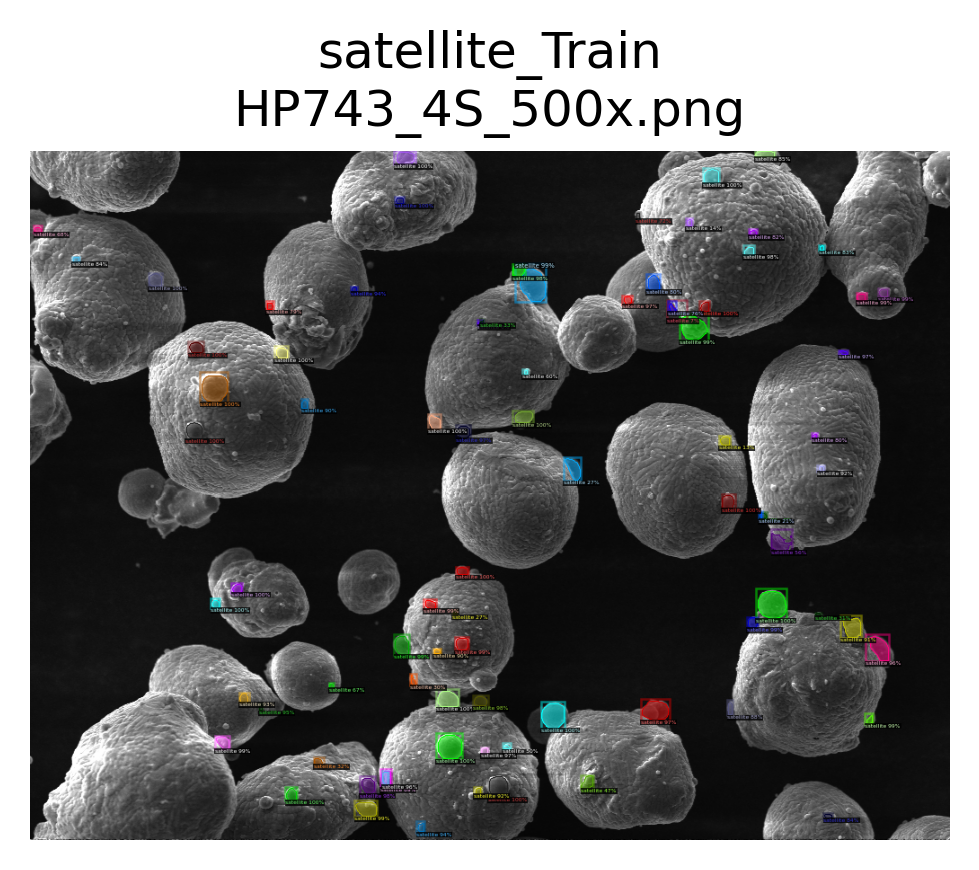

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_4S_500x.png
	num_instances: 82
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_500x.png


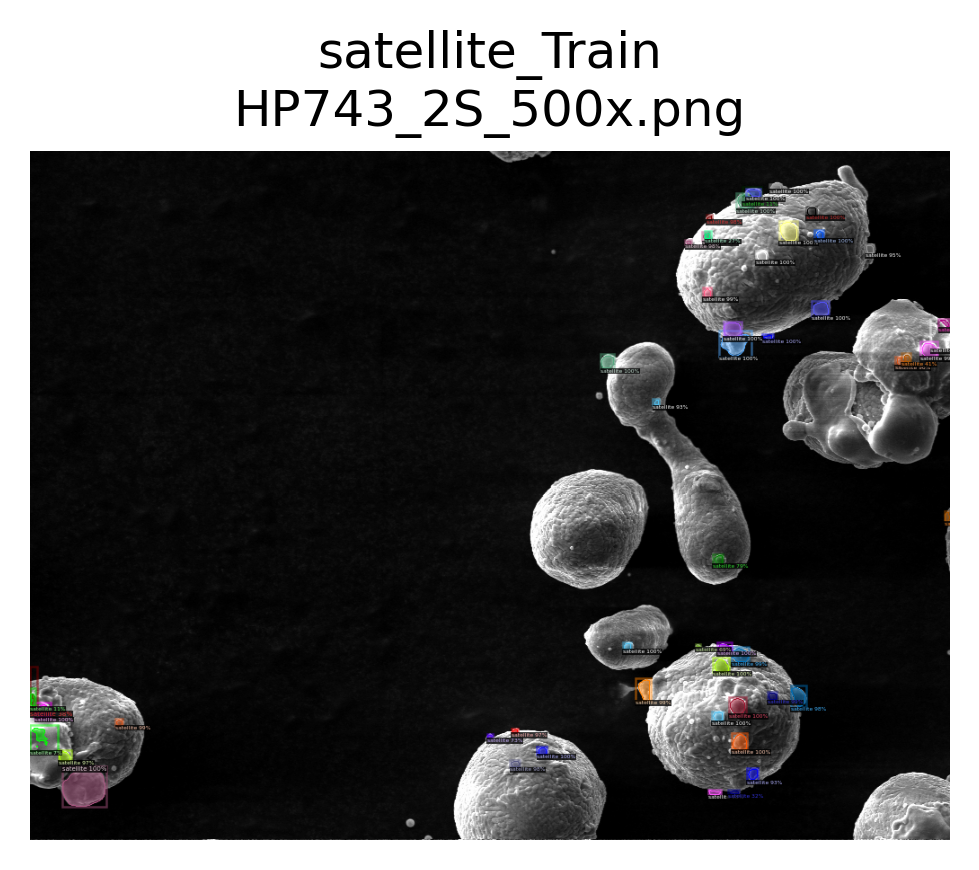

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_500x.png
	num_instances: 52
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_500x.png


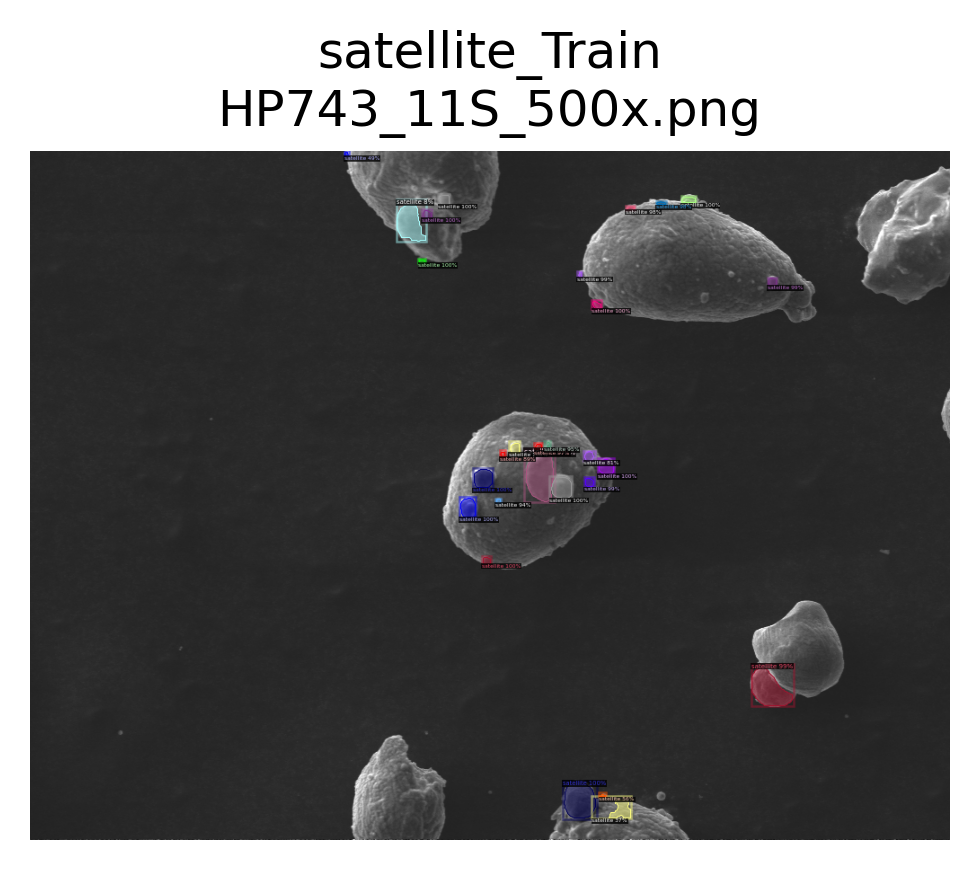

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_500x.png
	num_instances: 28
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_10S_500x.png


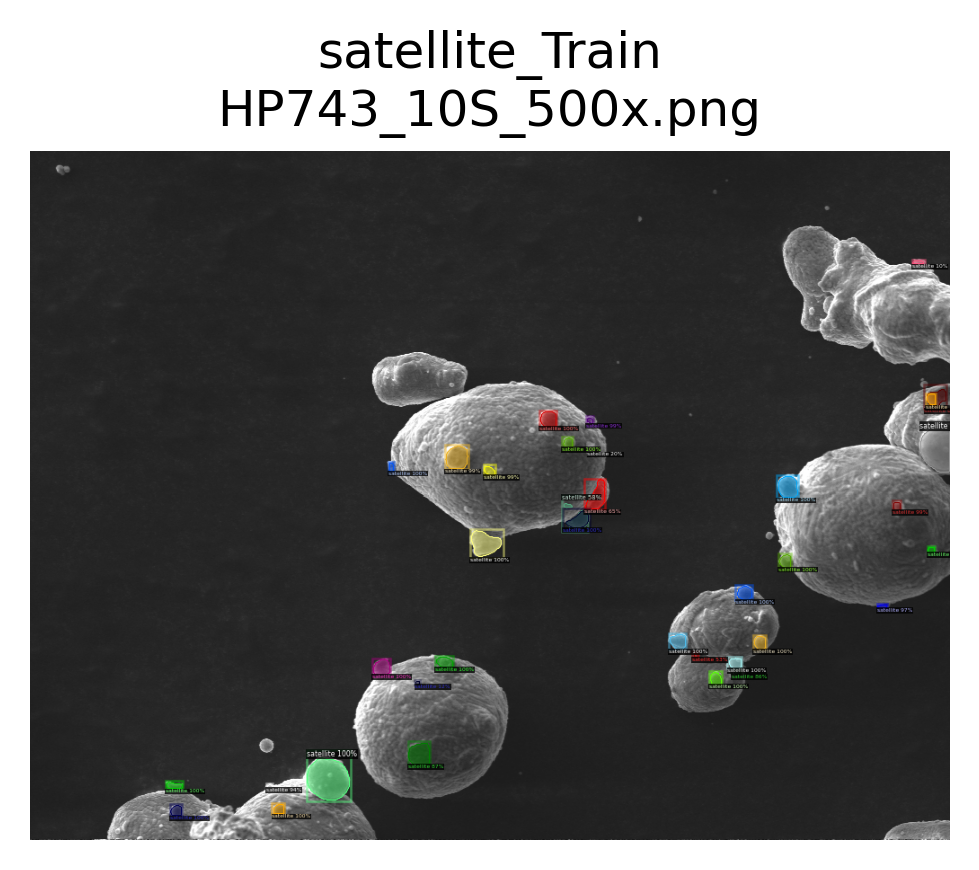

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_10S_500x.png
	num_instances: 36
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_12S_500x.png


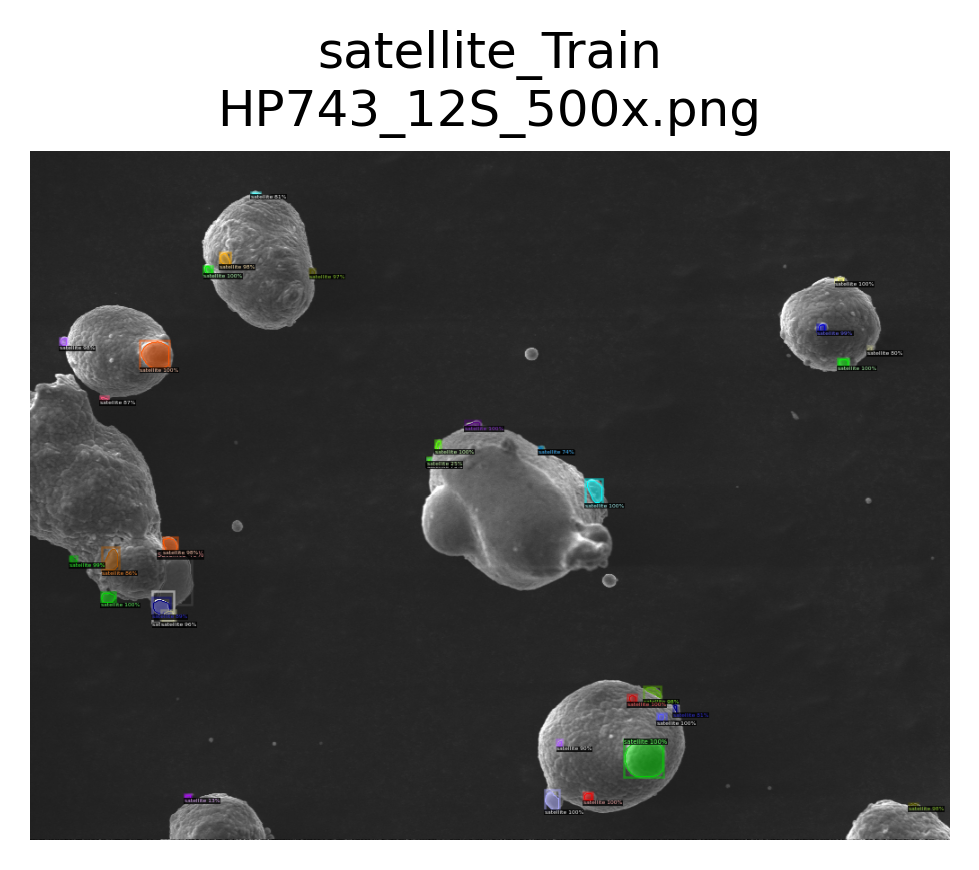

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_12S_500x.png
	num_instances: 37
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_3S_500x.png


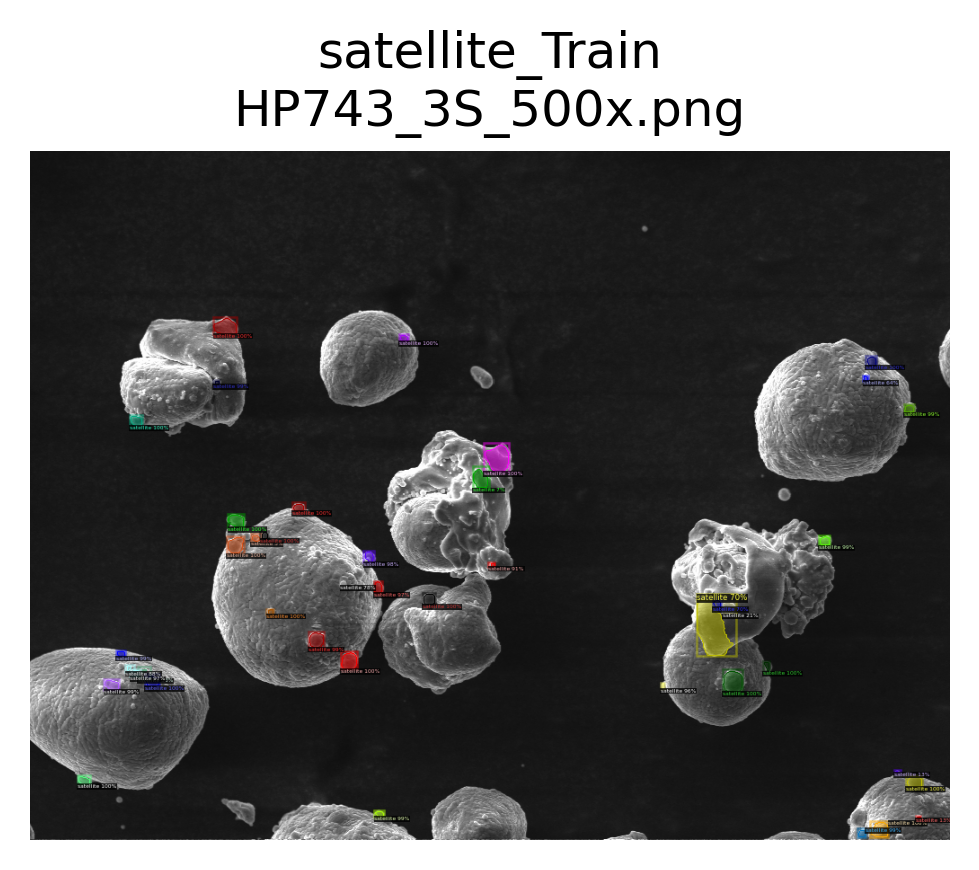

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_3S_500x.png
	num_instances: 42
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_1S_500x.png


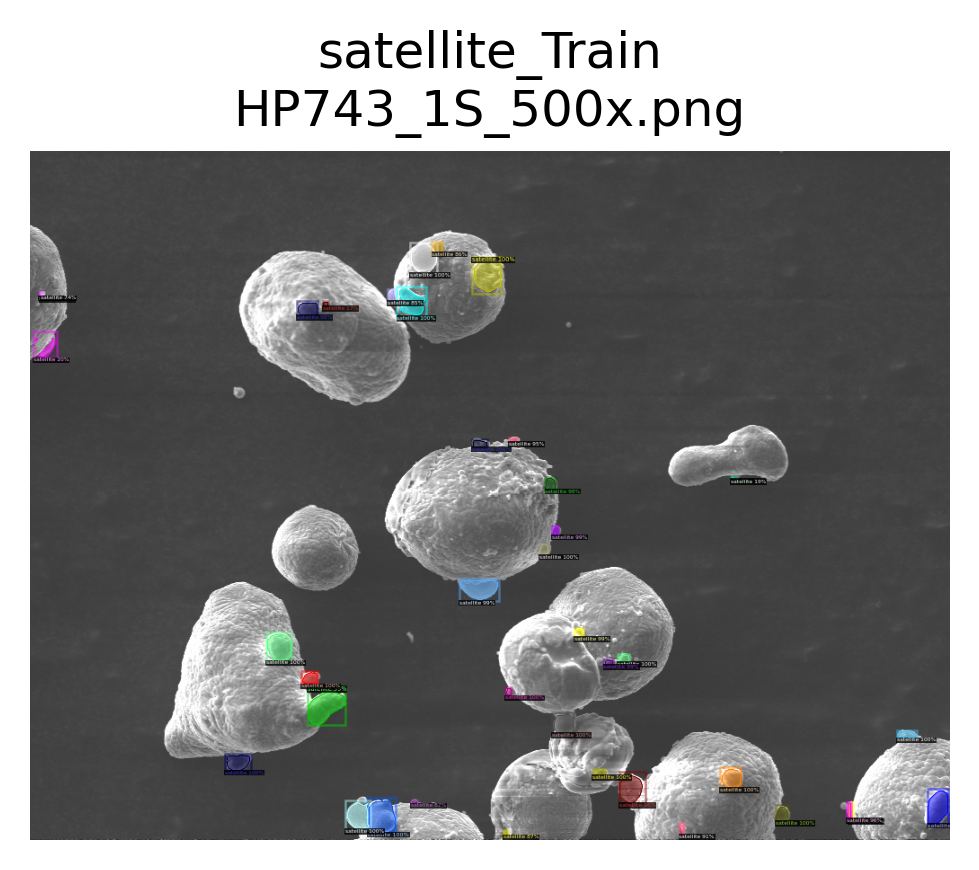

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_1S_500x.png
	num_instances: 41
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_5S_500x.png


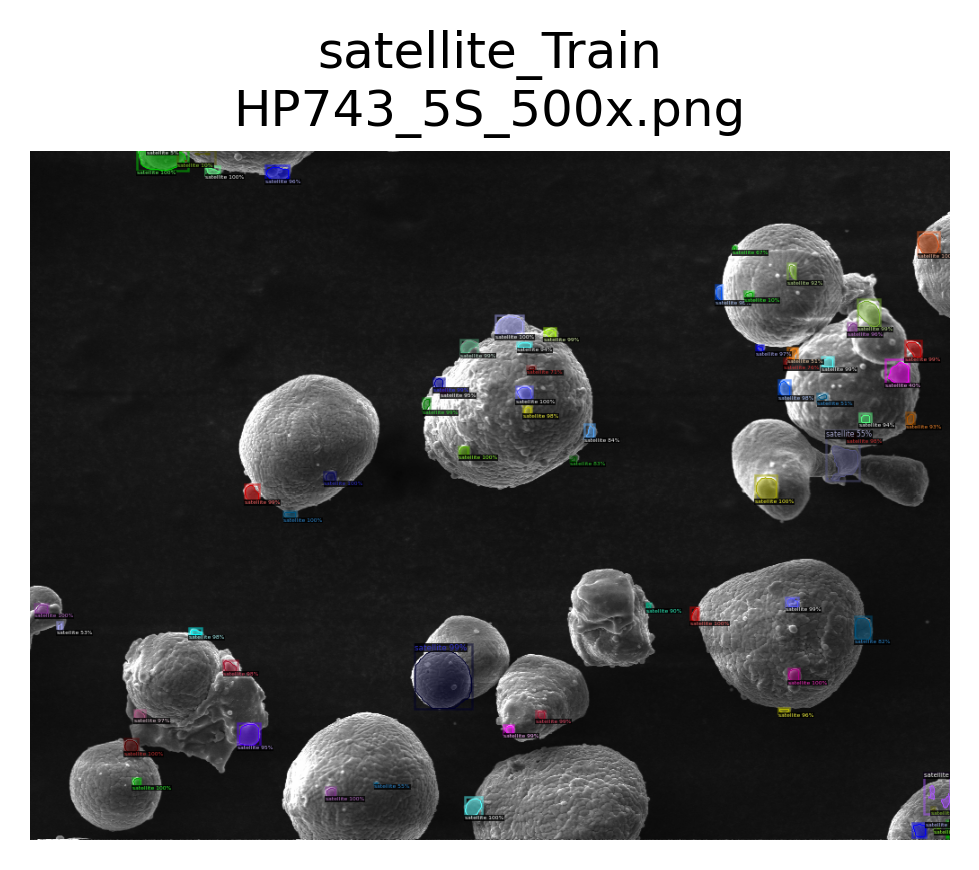

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_5S_500x.png
	num_instances: 66
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_02_SE1_1250X35.png


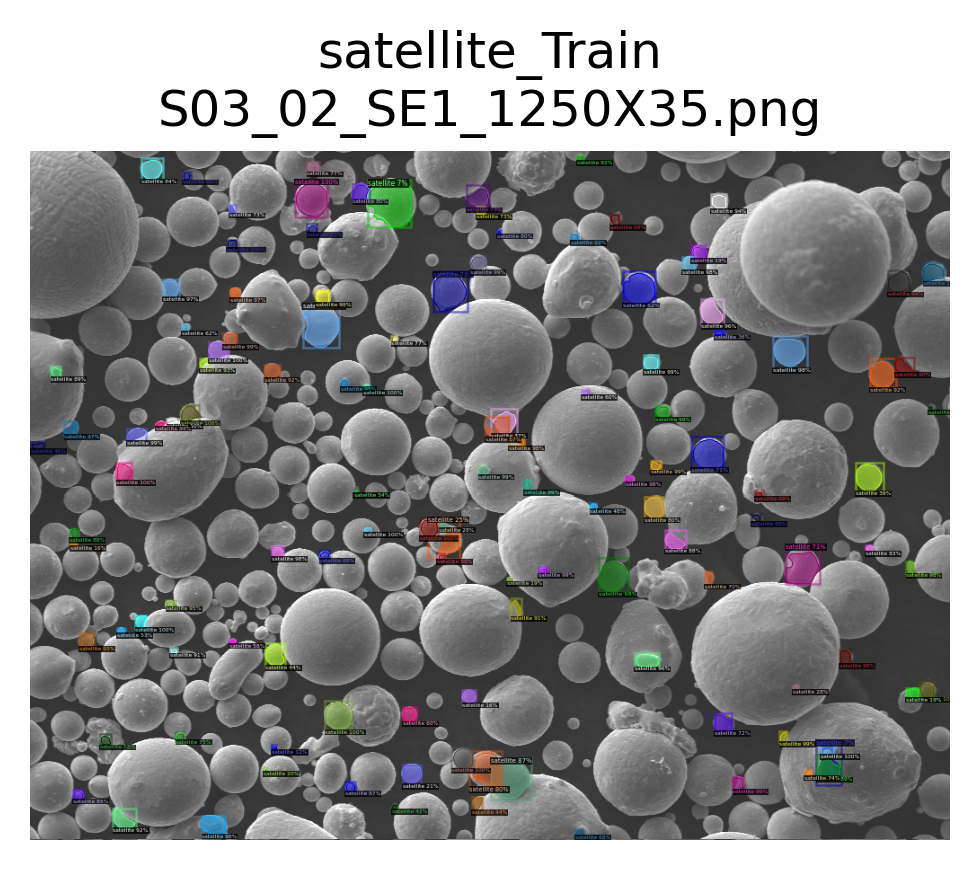

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_02_SE1_1250X35.png
	num_instances: 123
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_01_SE1_1250X28.png


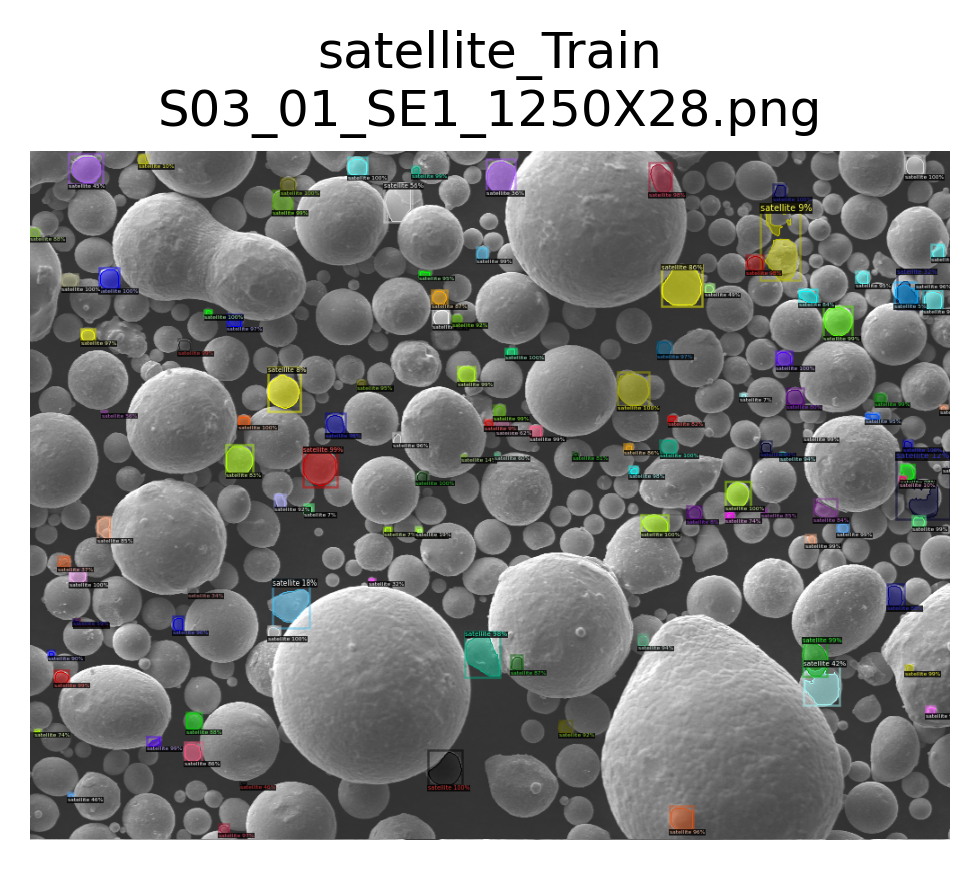

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_01_SE1_1250X28.png
	num_instances: 117
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_02_SE1_500X71.png


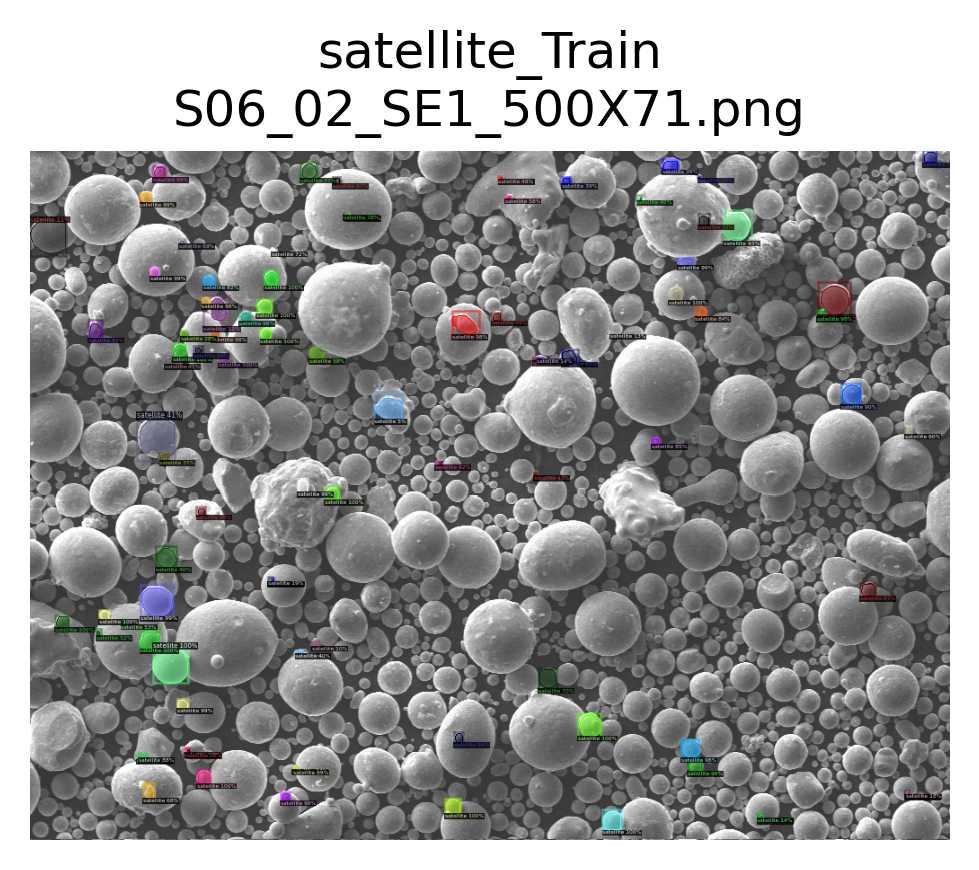

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_02_SE1_500X71.png
	num_instances: 91
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_03_SE1_500X75.png


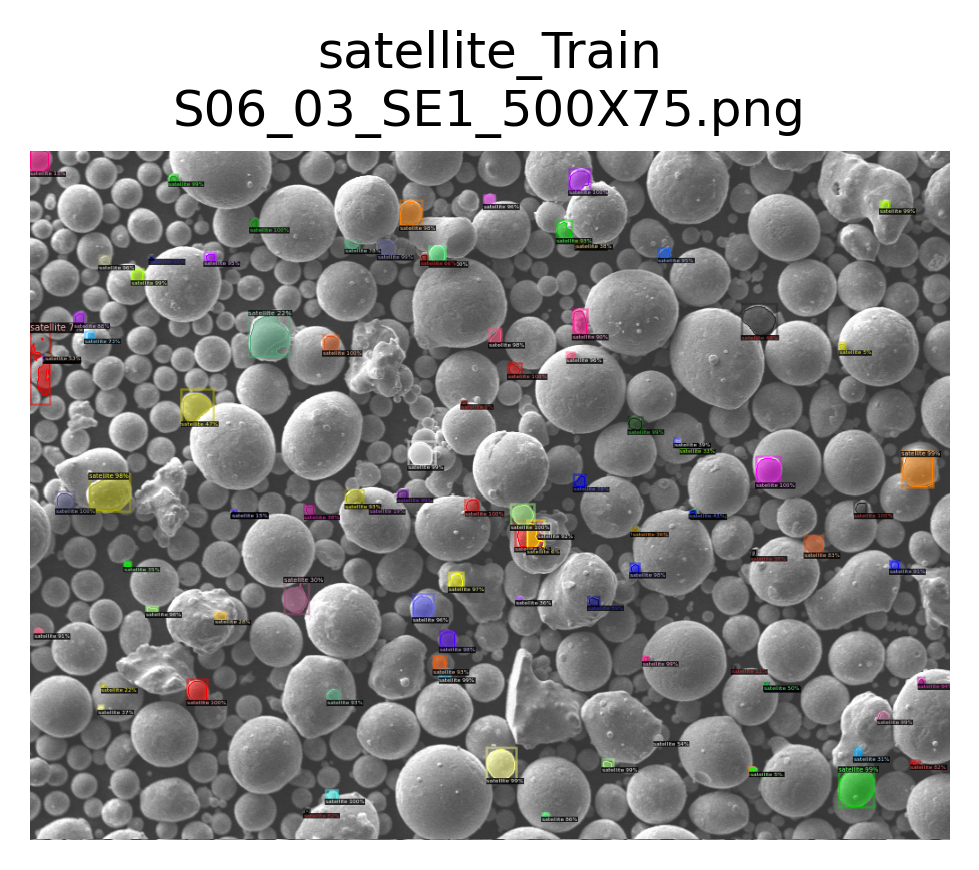

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_03_SE1_500X75.png
	num_instances: 100
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_02_SE1_300X18.png


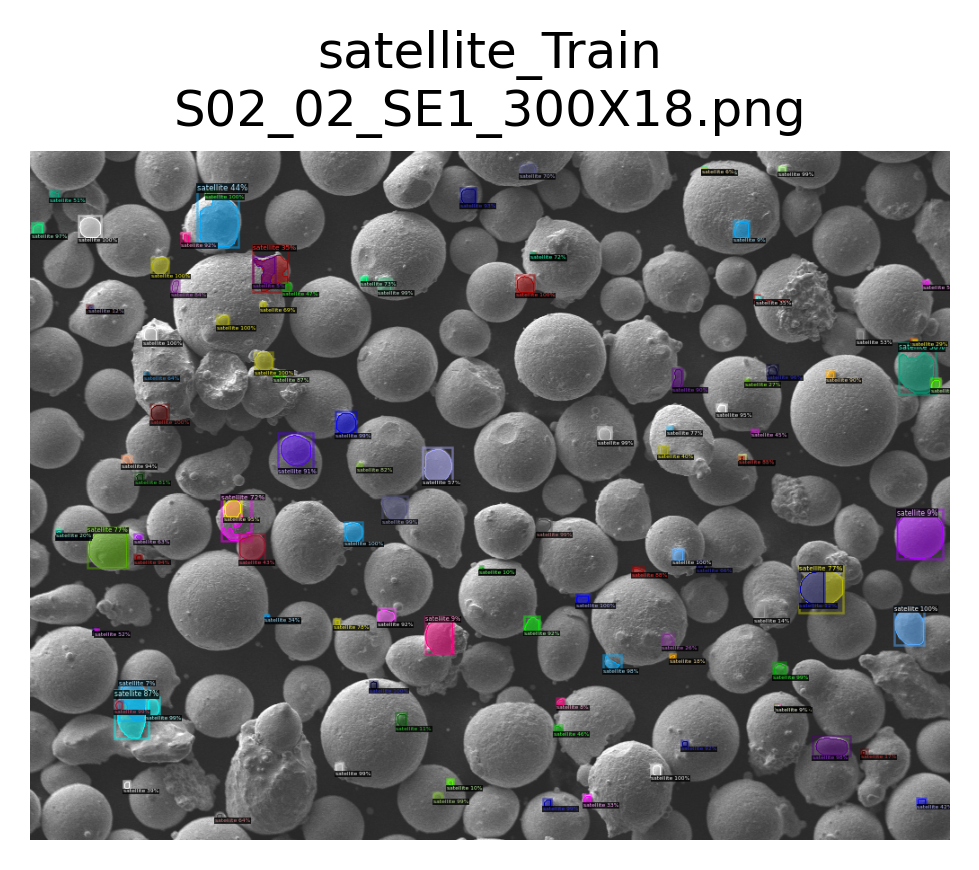

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_02_SE1_300X18.png
	num_instances: 114
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_03_SE1_300X22.png


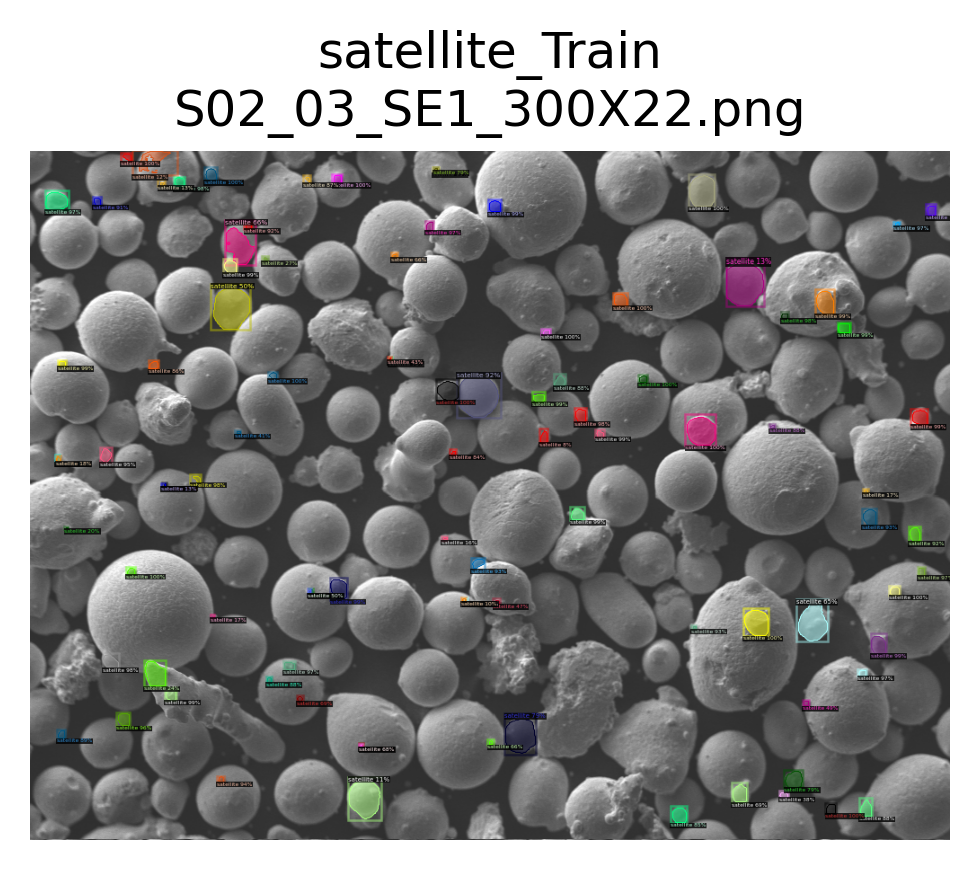

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_03_SE1_300X22.png
	num_instances: 95
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_250x.png


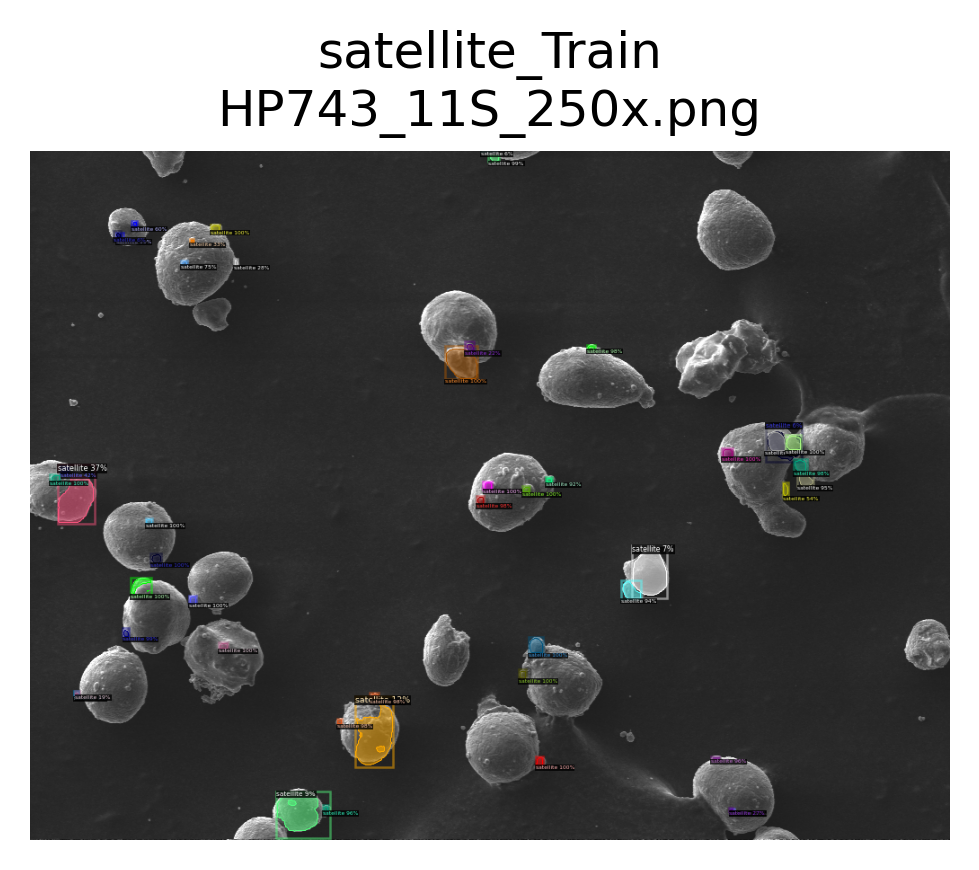

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_250x.png
	num_instances: 48
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_6S_250x.png


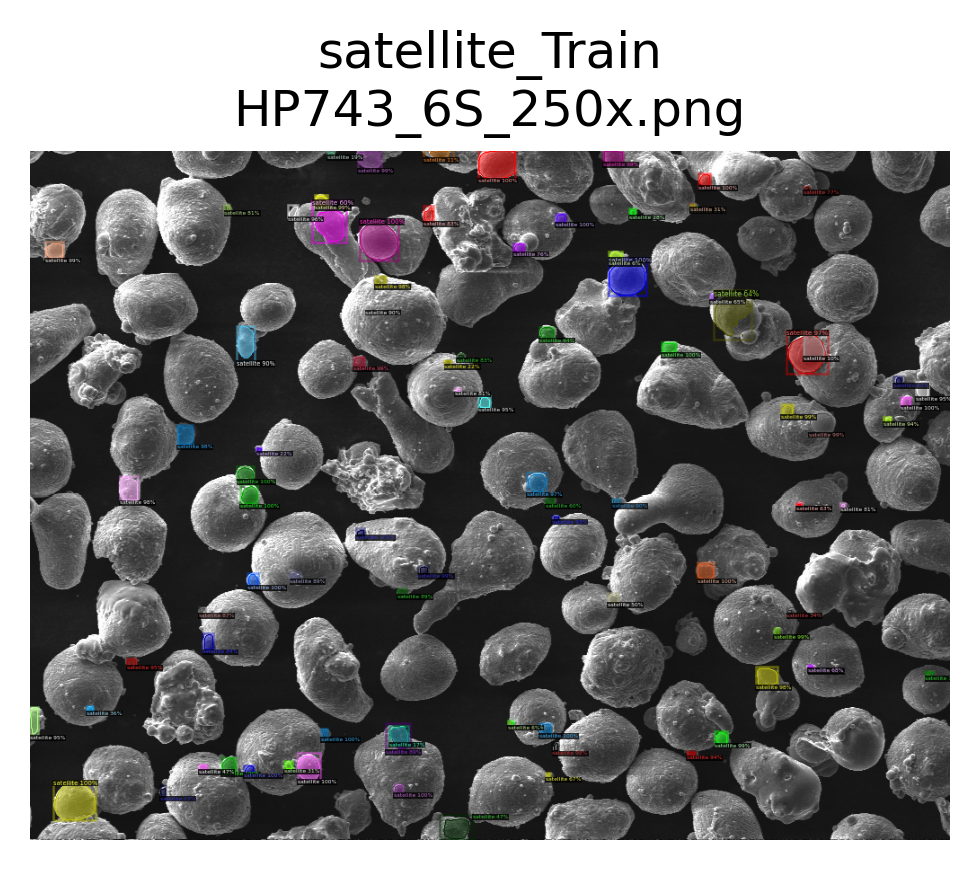

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_6S_250x.png
	num_instances: 90
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_02_SE1_1000X99.png


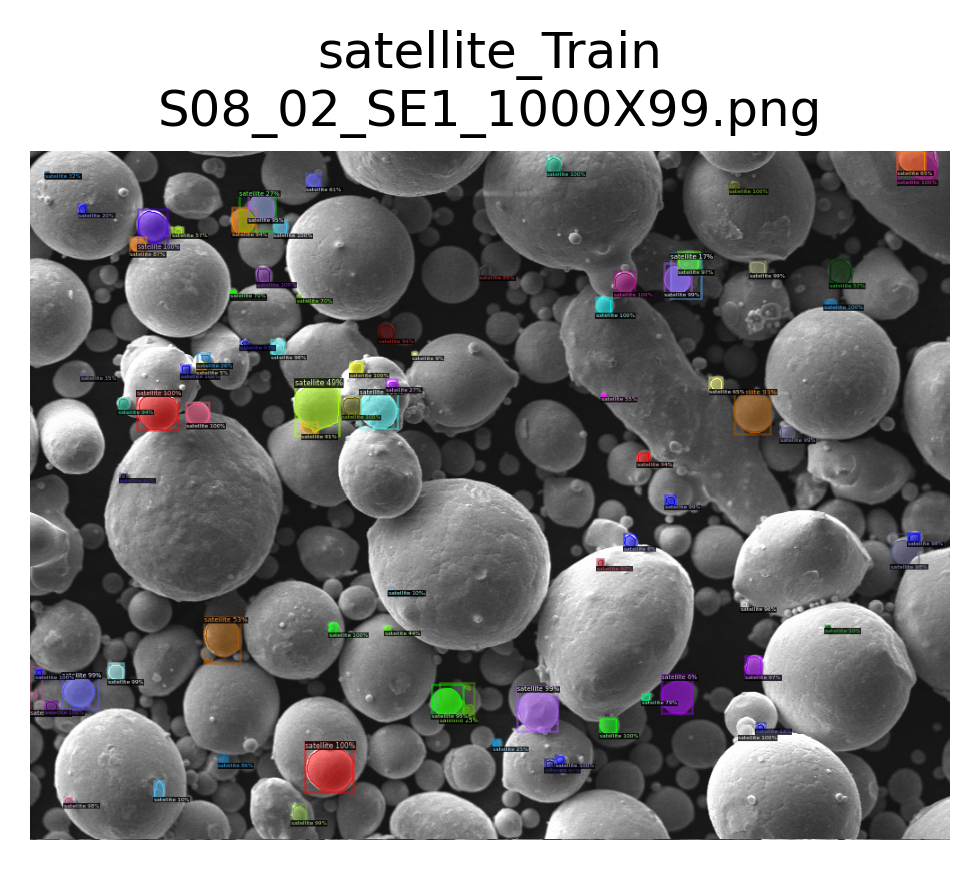

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_02_SE1_1000X99.png
	num_instances: 86
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_01_SE1_1000X94.png


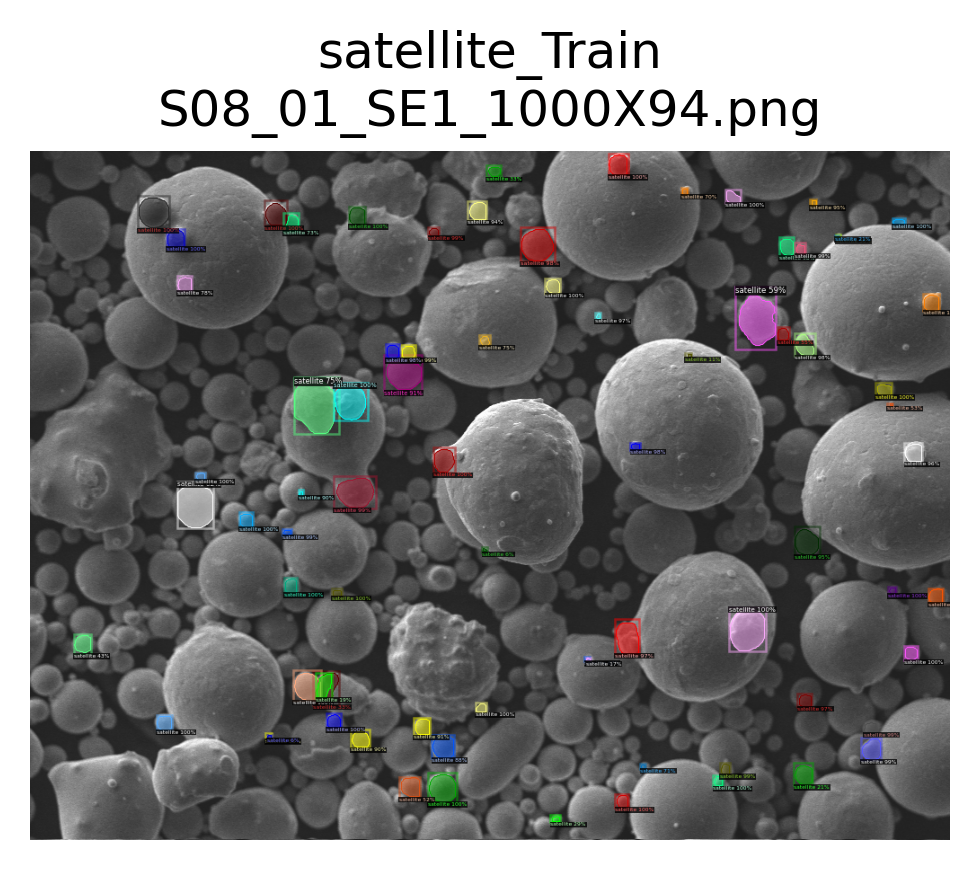

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_01_SE1_1000X94.png
	num_instances: 77
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_01_SE1_1000X45.png


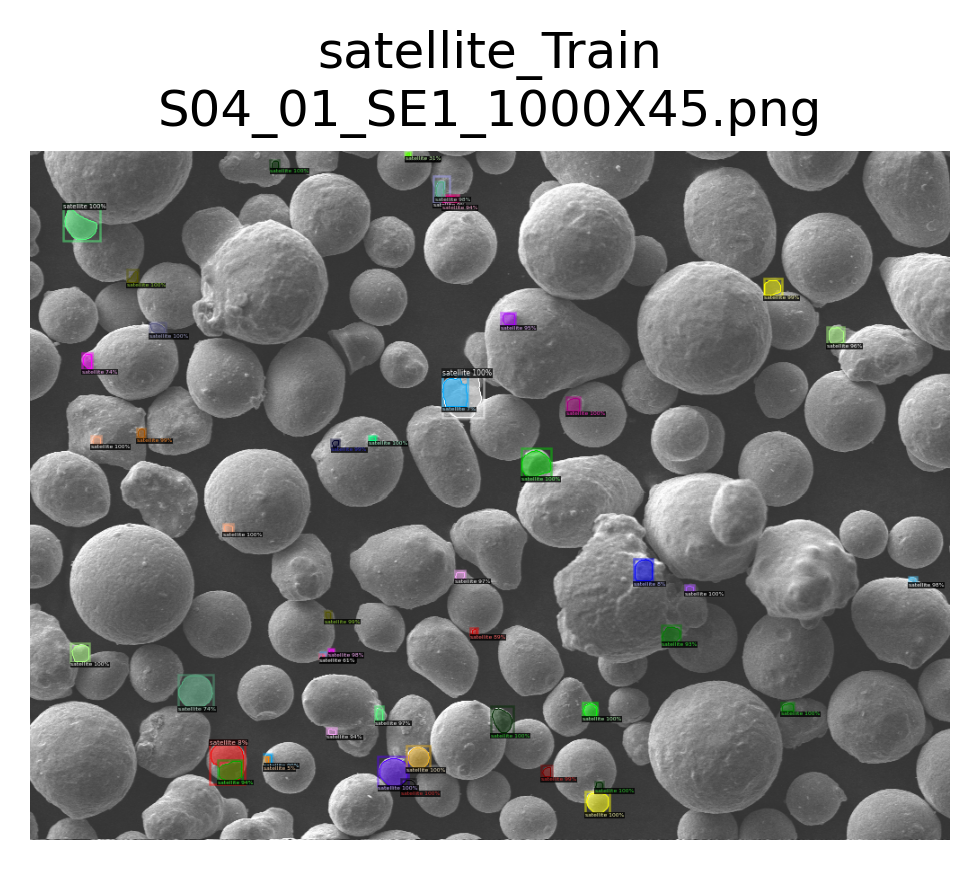

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_01_SE1_1000X45.png
	num_instances: 49
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_03_SE1_1000X53.png


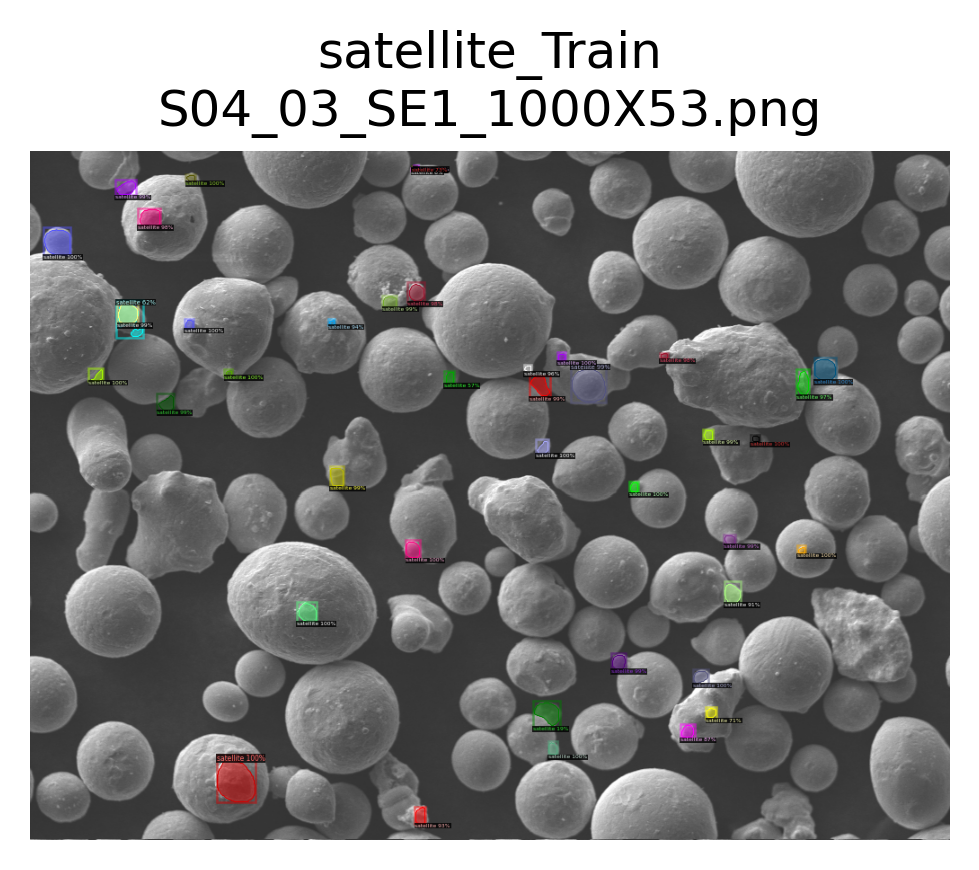

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_03_SE1_1000X53.png
	num_instances: 44
Dataset: satellite_Val
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png


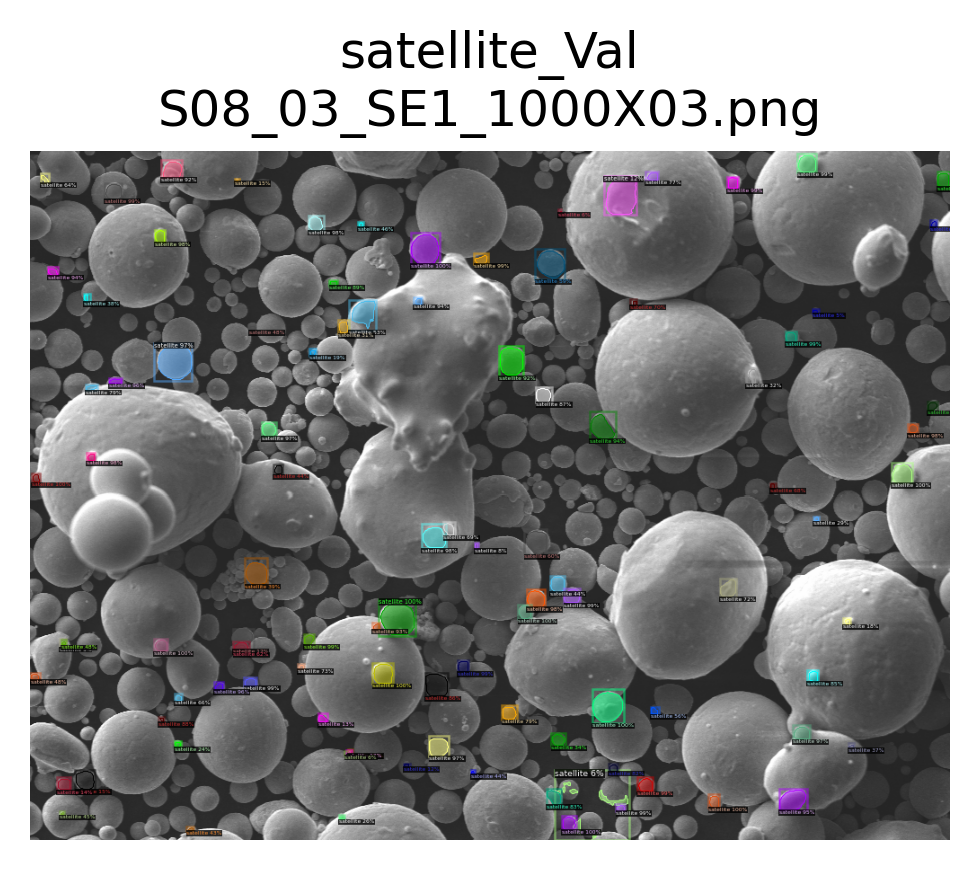

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png
	num_instances: 100
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png


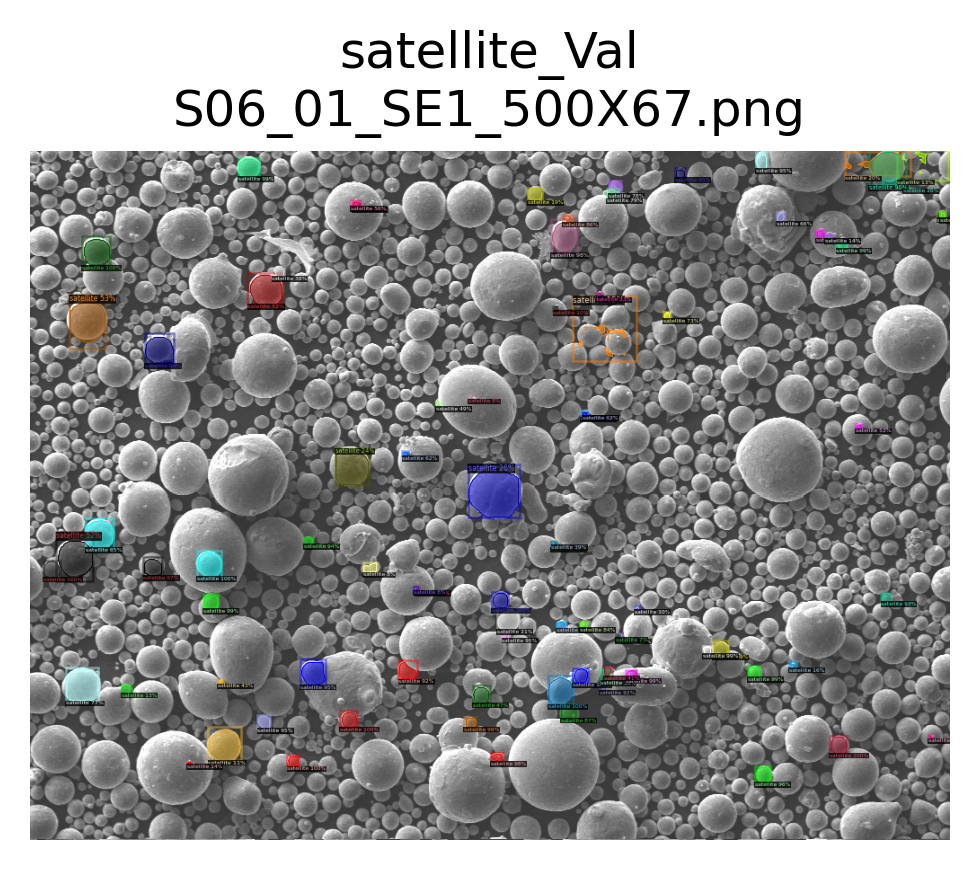

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png
	num_instances: 86
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png


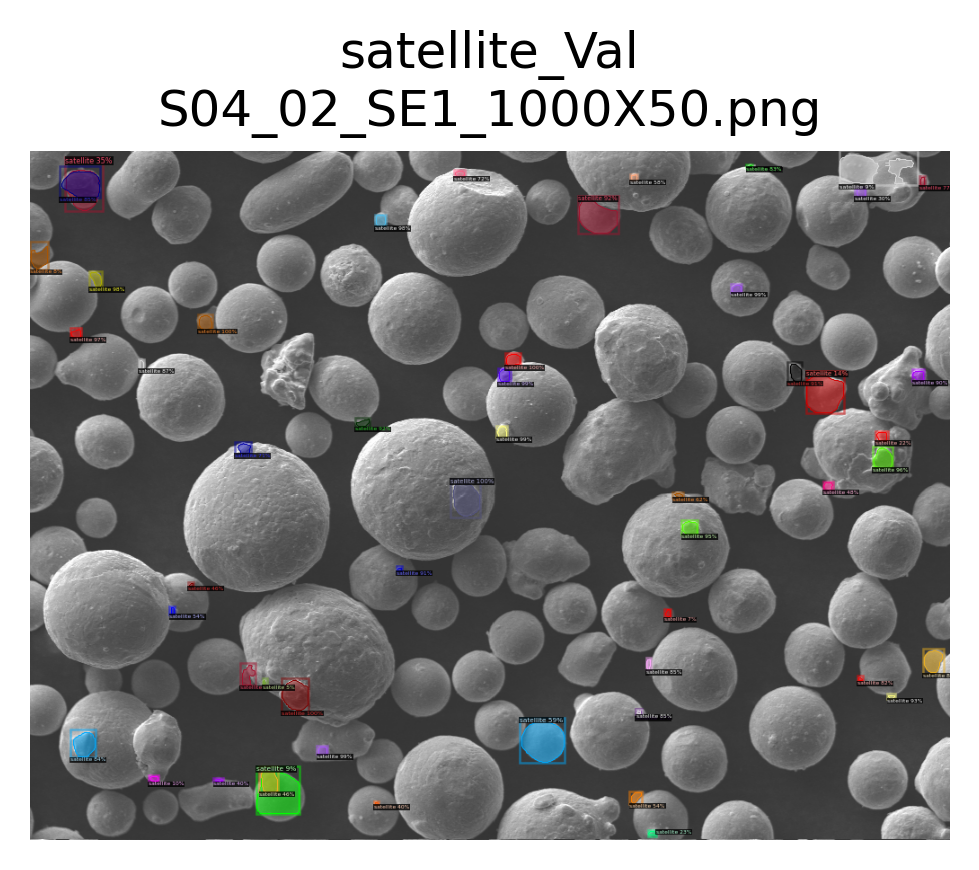

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png
	num_instances: 54
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png


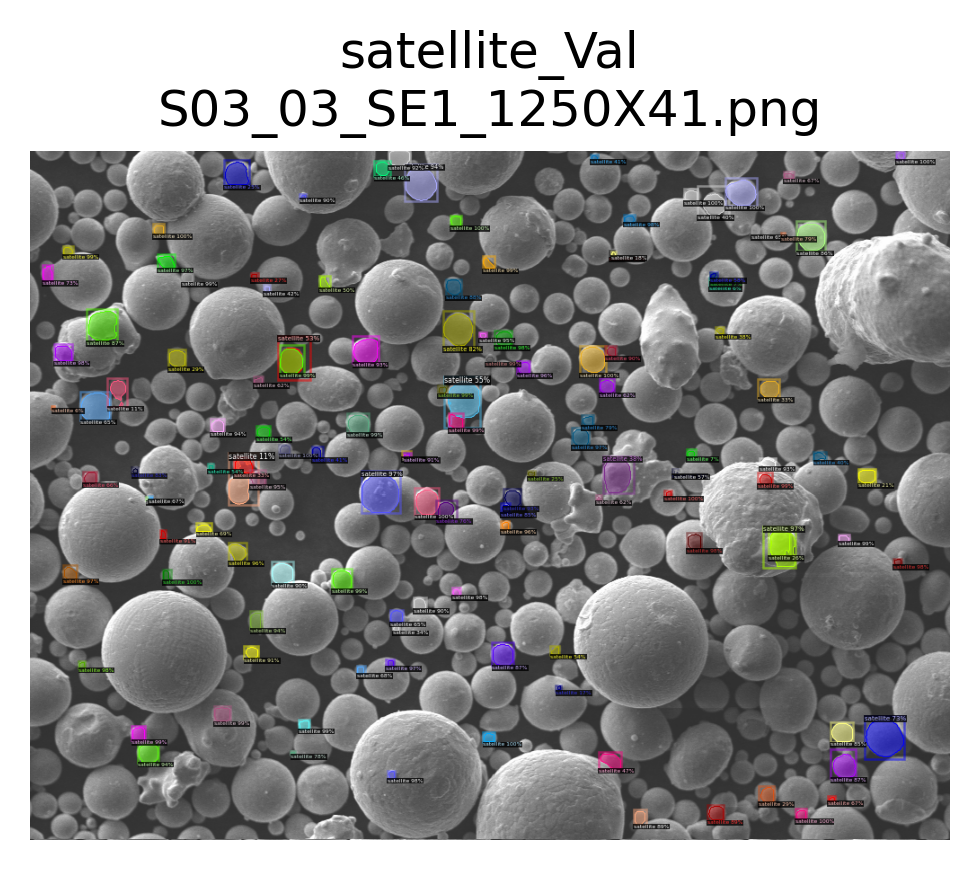

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png
	num_instances: 128
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png


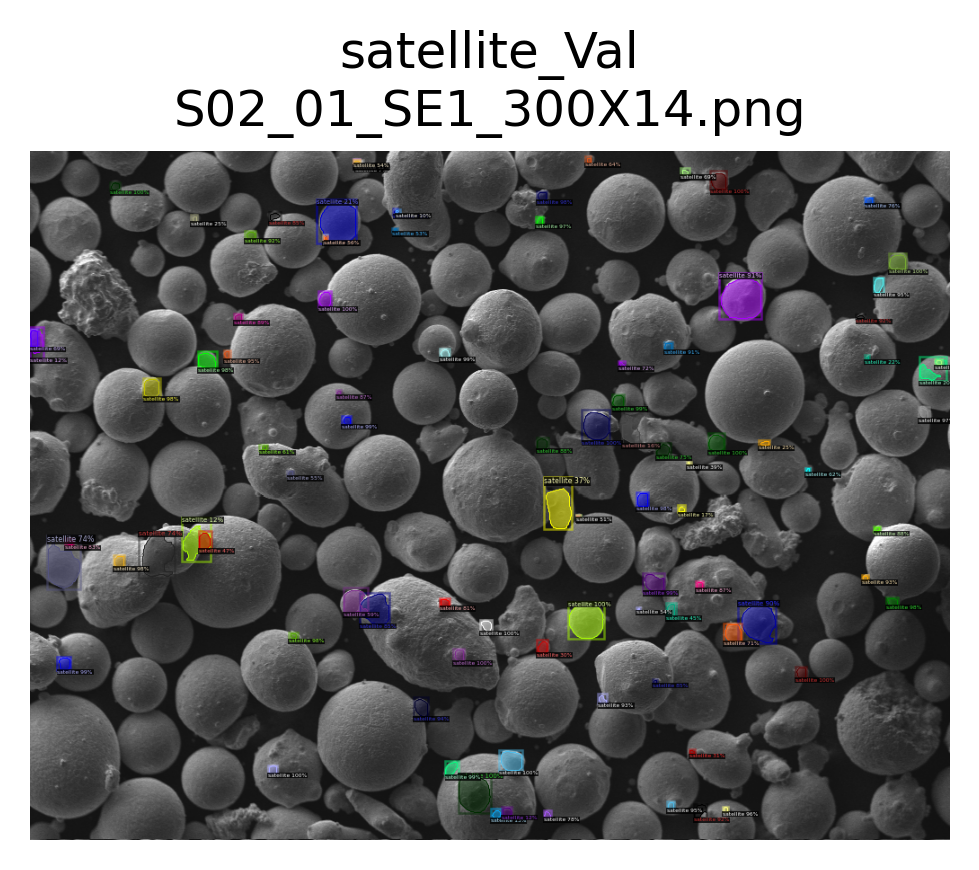

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png
	num_instances: 95
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png


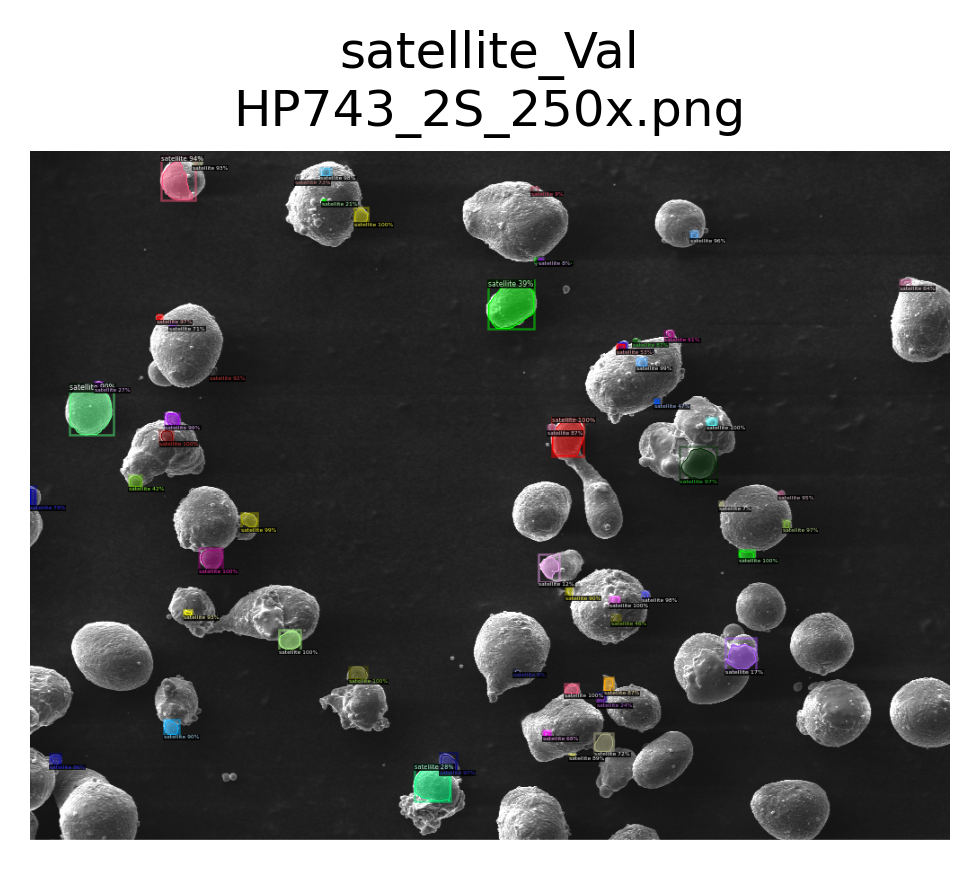

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png
	num_instances: 59


In [20]:
'''results = []
for ds in cfg.DATASETS.TEST:
    print(f'Dataset: {ds}')
    for dd in DatasetCatalog.get(ds):
        print(f'\tFile: {dd["file_name"]}')
        img = cv2.imread(dd['file_name'])  # load image
        outs = predictor(img)  # run inference on image
        
        # format results for visualization and store for later
        results.append(data_utils.format_outputs(dd['file_name'], ds, outs))

        # visualize results
        visualize.display_ddicts(outs, None, ds, gt=False, img_path=dd['file_name'])

# save to disk
#with open(Path('Stage_results',f'{EXPERIMENT_NAME}-base_stage.pickle'), 'wb') as f:
#    pickle.dump(results, f)'''

results = []
for ds in cfg.DATASETS.TEST:
    print(f'Dataset: {ds}')
    for dd in DatasetCatalog.get(ds):
        print(f'\tFile: {dd["file_name"]}')
        img = cv2.imread(dd['file_name'])  # load image
        outs = predictor(img)  # run inference on image
        # format results for visualization and store for later
        results.append(data_utils.format_outputs(dd['file_name'], ds, outs))
        # visualize results
        visualize.display_ddicts(outs, None, ds, gt=False, img_path=dd['file_name'])

In [ ]:
pickle_folder = []
#CREATING PREDICTOR
model_checkpoints = sorted(Path(cfg.OUTPUT_DIR).glob('*.pth'))  # paths to weights saved druing training
#cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # predictor requires this field to not be empty
for cycle in range(len(model_checkpoints)):
    cfg.MODEL.WEIGHTS = str(model_checkpoints[-cycle])  # use the last model checkpoint saved during training. If you want to see the performance of other checkpoints you can select a different index from model_checkpoints.
    print("USING MODEL WEIGHT: " + str(model_checkpoints[-cycle]))
    predictor = DefaultPredictor(cfg)  # create predictor object
    #SAVING RESULTS
    results = []
    for ds in cfg.DATASETS.VALIDATION:
        print(f'Dataset: {ds}')
        for dd in DatasetCatalog.get(ds):
            print(f'\tFile: {dd["file_name"]}')
            img = cv2.imread(dd['file_name'])  # load image
            outs = predictor(img)  # run inference on image
            
            # format results for visualization and store for later
            results.append(data_utils.format_outputs(dd['file_name'], ds, outs))

            # visualize results
            visualize.display_ddicts(outs, None, ds, gt=False, img_path=dd['file_name'])
    t_name = ((str(model_checkpoints[-cycle]).split('/'))[-1]).split('_')[-1].split('.pth')[0]
    # save to disk
    title = 'results_checkpoint_' + str(t_name) + '.pickle'
    with open(Path(ocean_images, 'weights', OUTPUT_FOLDER, title), 'wb') as f:
        pickle.dump(results, f)
    pickle_folder.append(title)
    #CALCULATING SEGMENTATION SCORES
    average_p = []
    average_r = []
    for i in range(1):
        #Loading Ground Truth Labels
        satellites_gt_path = Path(ocean_images, 'satellite_auto_validation_v1.2.json')
        for path in [satellites_gt_path]:
            assert path.is_file(), f'File not found : {path}'
        satellites_gt_dd = data_utils.get_ddicts('via2', satellites_gt_path, dataset_class='train')
        #Loading Prediction Labels
        satellites_path = Path(ocean_images, 'weights', OUTPUT_FOLDER, title)
        assert satellites_path.is_file()
        with open(satellites_path, 'rb') as f:
            satellites_pred = pickle.load(f)
        iset_satellites_gt = [InstanceSet().read_from_ddict(x, inplace=False) for x in satellites_gt_dd]
        iset_satellites_pred = [InstanceSet().read_from_model_out(x, inplace=False) for x in satellites_pred]
        #Creating Instance Set Objects
        iset_satellites_gt, iset_satellites_pred = analyze.align_instance_sets(iset_satellites_gt, iset_satellites_pred)
        #Re-ordering instance sets to be concurrent
        for gt, pred in zip(iset_satellites_gt, iset_satellites_pred):
            pred.HFW = gt.HFW
            pred.HFW_units = gt.HFW_units
            print(f'gt filename: {Path(gt.filepath).name}\t pred filename: {Path(pred.filepath).name}')
        #Creating Detection Scores
        dss_satellites = [analyze.det_seg_scores(gt, pred, size=gt.instances.image_size)
                        for gt, pred in zip(iset_satellites_gt, iset_satellites_pred)]
        labels = []
        counts = {'train': 0, 'validation': 0}
        for iset in iset_satellites_gt:
            counts[iset.dataset_class] += 1
            labels.append(iset.filepath.name)
        x=[*([1] * len(labels)), *([2] * len(labels))]
        # y values are the bar heights

        scores = [*[x['det_precision'] for x in dss_satellites],
            *[x['det_recall'] for x in dss_satellites]]
        labels = labels * 2
        print('x: ', x)
        print('y: ', [np.round(x, decimals=2) for x in scores])
        #print('labels: ', labels)
        fig, ax = plt.subplots(figsize=(6,3), dpi=150)
        sns.barplot(x=x, y=scores, hue=labels, ax=ax)
        ax.legend(bbox_to_anchor=(1,1))
        ax.set_ylabel('detection score')
        ax.set_xticklabels(['precision','recall'])
        print("Average Precision Score: ", str(sum([*[x['det_precision'] for x in dss_satellites]])/len([*[x['det_precision'] for x in dss_satellites]])))
        print("Average Recall Score:    ", str(sum([*[x['det_recall'] for x in dss_satellites]])/len([*[x['det_recall'] for x in dss_satellites]])))
        #Analyzing Prediction Scores on a pixel level
        temp_p = []
        temp_r = []
        total_area = 1024*768
        for instance in range(len(iset_satellites_pred)):
            fp_area = 0
            fn_area = 0
            tp_area = 0
            iset_satellites_pred[instance].compute_rprops(keys=['area'])
            for i in dss_satellites[instance]['det_fp']:
                try: 
                    fp_area += int(iset_satellites_pred[instance].rprops['area'][i])
                except:
                    pass

            for i in dss_satellites[instance]['det_fn']:
                try: 
                    fn_area += int(iset_satellites_pred[instance].rprops['area'][i])
                except:
                    pass

            #print(dss_satellites[0]['seg_tp'])
            for i in dss_satellites[instance]['det_tp']:
                try: 
                    tp_area += int(iset_satellites_pred[instance].rprops['area'][i[1]])
                except:
                    pass
            print("Precision:", str(tp_area/(tp_area+fp_area)))
            print('Recall:', str(tp_area/(tp_area+fn_area)))
            temp_p.append(tp_area/(tp_area+fp_area))
            temp_r.append(tp_area/(tp_area+fn_area))
            print('---')
        average_p.append(temp_p)
        average_r.append(temp_r)
        '''counter = 0   
        for iset in iset_satellites_gt:
            gt = iset_satellites_gt[counter]
            pred = iset_satellites_pred[counter]
            iset_det, colormap = analyze.det_perf_iset(gt, pred)
            img = skimage.color.gray2rgb(skimage.io.imread(iset.filepath))
            #display_iset(img, iset=iset_det)
            counter += 1'''
    del (average_p[0])[-1]
    del (average_r[0])[-1]
    file_name = 'SALAS_Replication_NT.txt'
    iteration_name = ((str(model_checkpoints[-cycle]).split('/'))[-1]).split('_')[-1].split('.pth')[0]
    if iteration_name == 'final':
        print("Ignoring Final Model")
    else:
        return_list = [LR, WD, BB, str(int(iteration_name)), str(sum(average_p[0])/len(average_p[0])), str(sum(average_r[0])/len(average_r[0]))]
        with open(file_name, "a") as output:
            output.write(str(return_list))
        f = open(file_name, "a")
        f.write('\n')
        f.close()

In [ ]:
for model in range(len(model_checkpoints)):
    print("Deleting: " + str(model_checkpoints[-model]))
    os.remove(str(model_checkpoints[-model]))
for file in range(len(pickle_folder)):
    temp = "../../../../../../../ocean/projects/dmr200021p/sprice/tuning/weights/" + OUTPUT_FOLDER + "/" + pickle_folder[file]
    print("Deleting: " + temp)
    os.remove(temp)
print("Removing: " + "../../../../../../../ocean/projects/dmr200021p/sprice/tuning/weights/" + OUTPUT_FOLDER  + "/" +"metrics.json")
os.remove("../../../../../../../ocean/projects/dmr200021p/sprice/tuning/weights/" + OUTPUT_FOLDER  + "/" +"metrics.json")
print("Removing: " + "../../../../../../../ocean/projects/dmr200021p/sprice/tuning/weights/" + OUTPUT_FOLDER + "/" +"last_checkpoint")
os.remove("../../../../../../../ocean/projects/dmr200021p/sprice/tuning/weights/" + OUTPUT_FOLDER + "/" + "last_checkpoint")